#### Training a network for audio classification - Using Urban8K dataset
Written by : leopauly | cnlp@leeds.ac.uk

In [1]:
import wave
import pandas as pd
import numpy as np
import os
import struct
from scipy.io import wavfile as wav
import matplotlib.pyplot as plt
import IPython.display as ipd
import pylab
import pickle

In [2]:
window_size = 512

# Dataset parameters
work_dir = "/nobackup/leopauly/UrbanSound8K/audio"
classes={
'0':'air_conditioner',
'1':'car_horn',
'2':'children_playing',
'3':'dog_bark',
'4':'drilling',
'5':'engine_idling',
'6':'gun_shot',
'7':'jackhammer',
'8':'siren',
'9':'street_music'
}

In [3]:
def windows(data, n_frames):  # Overlap of 50%
    ws = window_size * (n_frames - 1)
    start = 0
    while start < len(data):
        yield start, start + ws, ws
        start += (ws / 2)

In [4]:
def extract_features():
    Y = []
    X=[]
    cnt = 0
    
    for sub_dir in os.listdir(work_dir):
        print("Working on dir: ", sub_dir)
        if (sub_dir=='.DS_Store') : break# continue
        
        for fs in os.listdir(work_dir + "/" + sub_dir):
            if ".wav" not in fs: continue
            print('fs',fs)
            
            try:
    
                wav = wave.open(work_dir + "/" + sub_dir + "/" +fs, 'r')
                frames = wav.readframes(-1)
                sound_info = pylab.fromstring(frames, 'Int16')
                frame_rate = wav.getframerate()
                wav.close()


                label = fs.split('-')[1]
                print(cnt, ":Loading file: ", fs, " class: ", classes[str(label)])
                cnt += 1


                (Pxx, freqs, bins, im)=pylab.specgram(sound_info, NFFT=512, Fs=frame_rate)
                print(Pxx.shape)
                Pxx=np.log(Pxx)
                #pylab.show(Pxx)
                plt.imshow(Pxx)
                plt.show()

                Y.append(label)
                X.append(Pxx)
           
            except Exception:
                pass
            
    return X,Y
            
            


Working on dir:  fold10
fs 196084-2-0-2.wav
0 :Loading file:  196084-2-0-2.wav  class:  children_playing
(257, 918)


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:18: DeprecationWarning: Numeric-style type codes are deprecated and will result in an error in the future.


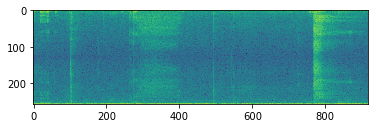

fs 117889-9-0-12.wav
1 :Loading file:  117889-9-0-12.wav  class:  street_music
(257, 918)


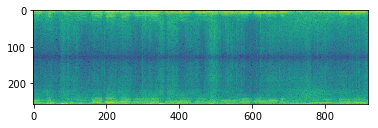

fs 188813-7-10-3.wav
fs 72220-3-2-4.wav
2 :Loading file:  72220-3-2-4.wav  class:  dog_bark
(257, 918)


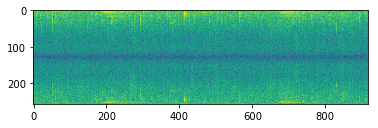

fs 207213-2-0-109.wav
fs 28808-1-0-10.wav
3 :Loading file:  28808-1-0-10.wav  class:  car_horn
(257, 918)


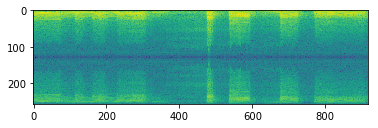

fs 27070-2-0-5.wav
4 :Loading file:  27070-2-0-5.wav  class:  children_playing
(257, 918)


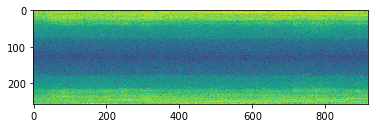

fs 155262-2-0-58.wav
fs 187863-4-0-4.wav
5 :Loading file:  187863-4-0-4.wav  class:  drilling
(257, 166)


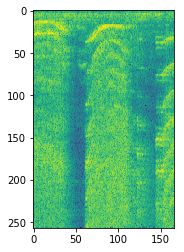

fs 189985-0-0-1.wav
6 :Loading file:  189985-0-0-1.wav  class:  air_conditioner
(257, 918)


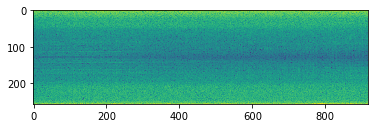

fs 28808-1-0-6.wav
7 :Loading file:  28808-1-0-6.wav  class:  car_horn
(257, 918)


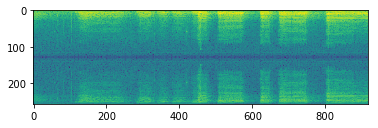

fs 74364-8-1-23.wav
8 :Loading file:  74364-8-1-23.wav  class:  siren
(257, 918)


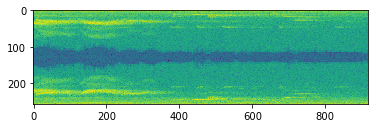

fs 83191-9-0-11.wav
9 :Loading file:  83191-9-0-11.wav  class:  street_music
(257, 499)


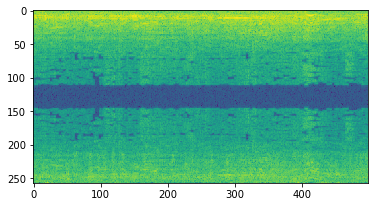

fs 26255-3-8-0.wav
10 :Loading file:  26255-3-8-0.wav  class:  dog_bark
(257, 134)


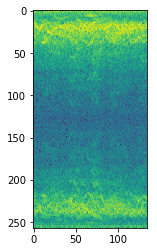

fs 99192-4-0-15.wav
11 :Loading file:  99192-4-0-15.wav  class:  drilling
(257, 459)


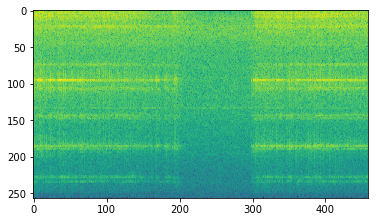

fs 83195-9-0-3.wav
12 :Loading file:  83195-9-0-3.wav  class:  street_music
(257, 499)


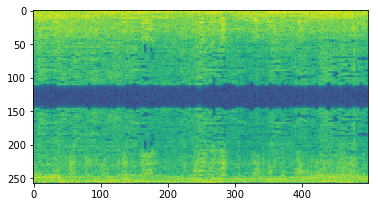

fs 14468-3-0-2.wav
13 :Loading file:  14468-3-0-2.wav  class:  dog_bark
(257, 918)


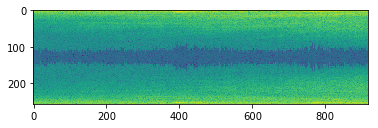

fs 74364-8-1-11.wav
14 :Loading file:  74364-8-1-11.wav  class:  siren
(257, 918)


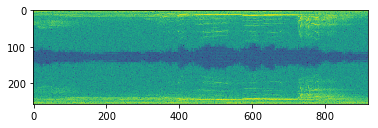

fs 7913-3-2-0.wav
15 :Loading file:  7913-3-2-0.wav  class:  dog_bark
(257, 180)


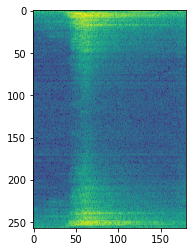

fs 189982-0-0-18.wav
16 :Loading file:  189982-0-0-18.wav  class:  air_conditioner
(257, 918)


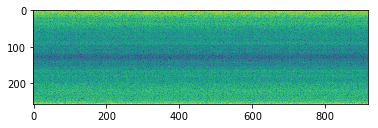

fs 181624-4-8-0.wav
fs 181624-4-6-0.wav
fs 99192-4-0-20.wav
17 :Loading file:  99192-4-0-20.wav  class:  drilling
(257, 459)


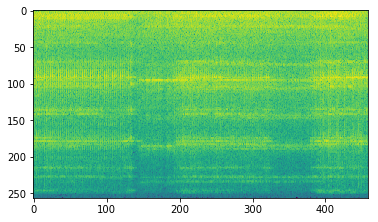

fs 155262-2-0-101.wav
fs 187863-4-0-1.wav
18 :Loading file:  187863-4-0-1.wav  class:  drilling
(257, 166)


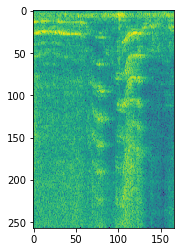

fs 103438-5-0-0.wav
19 :Loading file:  103438-5-0-0.wav  class:  engine_idling
(257, 918)


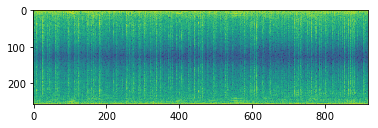

fs 15544-5-0-16.wav
fs 118278-4-0-7.wav
20 :Loading file:  118278-4-0-7.wav  class:  drilling
(257, 999)


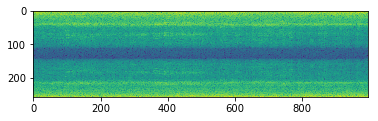

fs 162134-7-9-0.wav
fs 83502-0-0-4.wav
21 :Loading file:  83502-0-0-4.wav  class:  air_conditioner
(257, 918)


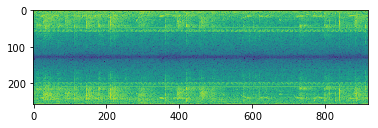

fs 162134-7-1-0.wav
fs 102857-5-0-13.wav
22 :Loading file:  102857-5-0-13.wav  class:  engine_idling
(257, 918)


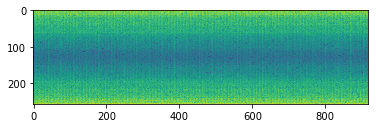

fs 189982-0-0-35.wav
23 :Loading file:  189982-0-0-35.wav  class:  air_conditioner
(257, 918)


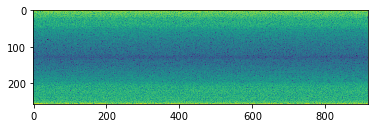

fs 162134-7-13-2.wav
fs 162134-7-11-0.wav
fs 167464-0-0-14.wav
fs 102857-5-0-19.wav
24 :Loading file:  102857-5-0-19.wav  class:  engine_idling
(257, 918)


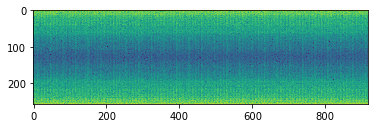

fs 188813-7-11-1.wav
fs 203424-9-0-34.wav
25 :Loading file:  203424-9-0-34.wav  class:  street_music
(257, 918)


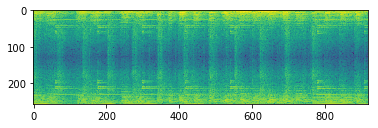

fs 128470-3-0-0.wav
fs 83191-9-0-17.wav
26 :Loading file:  83191-9-0-17.wav  class:  street_music
(257, 499)


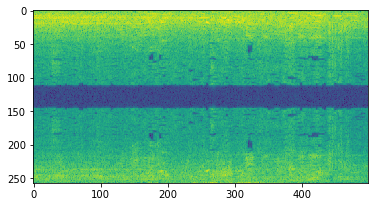

fs 99192-4-0-12.wav
27 :Loading file:  99192-4-0-12.wav  class:  drilling
(257, 459)


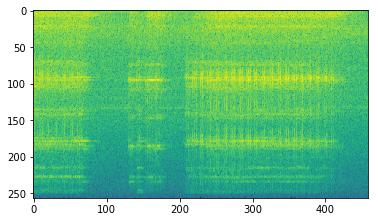

fs 188813-7-10-2.wav
fs 189982-0-0-16.wav
28 :Loading file:  189982-0-0-16.wav  class:  air_conditioner
(257, 918)


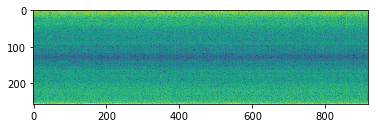

fs 102857-5-0-16.wav
29 :Loading file:  102857-5-0-16.wav  class:  engine_idling
(257, 918)


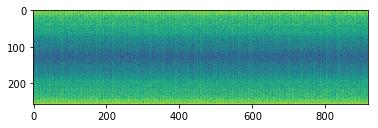

fs 162134-7-0-2.wav
fs 207213-2-0-134.wav
fs 74364-8-1-16.wav
30 :Loading file:  74364-8-1-16.wav  class:  siren
(257, 918)


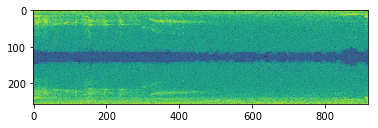

fs 162134-7-17-4.wav
fs 74922-4-0-3.wav
fs 101382-2-0-29.wav
31 :Loading file:  101382-2-0-29.wav  class:  children_playing
(257, 999)


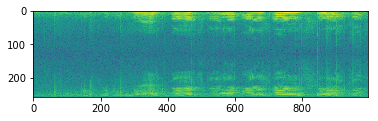

fs 203424-9-0-18.wav
32 :Loading file:  203424-9-0-18.wav  class:  street_music
(257, 918)


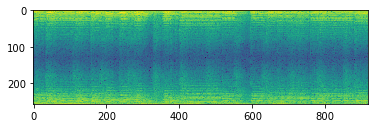

fs 74364-8-1-9.wav
33 :Loading file:  74364-8-1-9.wav  class:  siren
(257, 918)


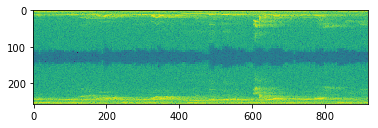

fs 164377-9-1-50.wav
fs 22973-3-0-2.wav
34 :Loading file:  22973-3-0-2.wav  class:  dog_bark
(257, 918)


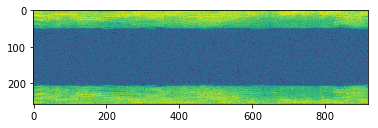

fs 93567-8-0-9.wav
35 :Loading file:  93567-8-0-9.wav  class:  siren
(257, 918)


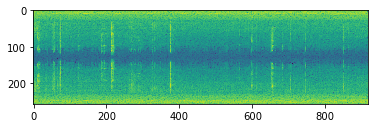

fs 209672-3-6-0.wav
36 :Loading file:  209672-3-6-0.wav  class:  dog_bark
(257, 168)


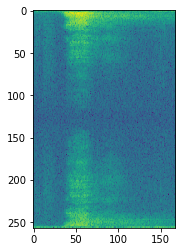

fs 24076-1-0-0.wav
37 :Loading file:  24076-1-0-0.wav  class:  car_horn
(257, 227)


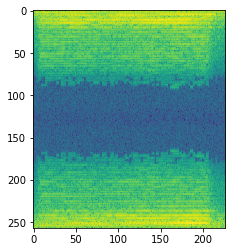

fs 83195-9-0-7.wav
38 :Loading file:  83195-9-0-7.wav  class:  street_music
(257, 499)


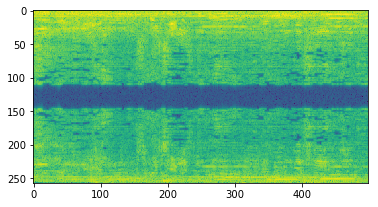

fs 159742-8-0-1.wav
fs 180127-4-0-13.wav
39 :Loading file:  180127-4-0-13.wav  class:  drilling
(257, 918)


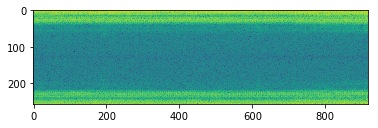

fs 128470-3-0-8.wav
fs 197554-2-0-23.wav
fs 101382-2-0-20.wav
40 :Loading file:  101382-2-0-20.wav  class:  children_playing
(257, 999)


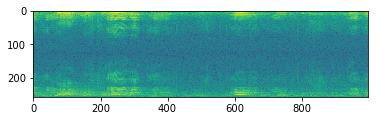

fs 81791-3-0-0.wav
41 :Loading file:  81791-3-0-0.wav  class:  dog_bark
(257, 999)


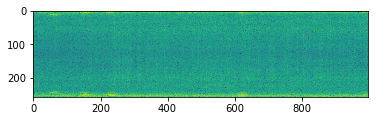

fs 162134-7-12-1.wav
fs 99192-4-0-17.wav
42 :Loading file:  99192-4-0-17.wav  class:  drilling
(257, 459)


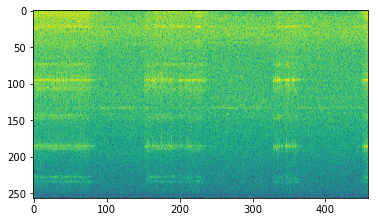

fs 118278-4-0-9.wav
43 :Loading file:  118278-4-0-9.wav  class:  drilling
(257, 999)


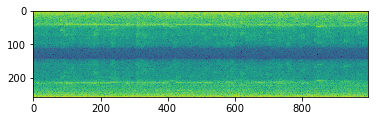

fs 99192-4-0-28.wav
44 :Loading file:  99192-4-0-28.wav  class:  drilling
(257, 459)


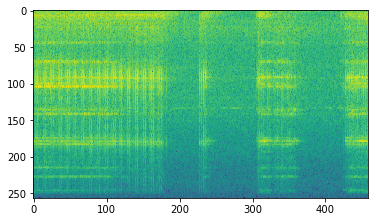

fs 99192-4-0-53.wav
45 :Loading file:  99192-4-0-53.wav  class:  drilling
(257, 459)


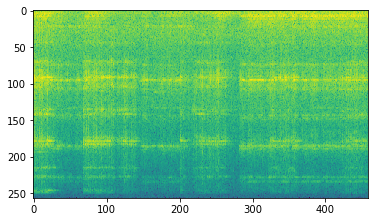

fs 118278-4-0-0.wav
46 :Loading file:  118278-4-0-0.wav  class:  drilling
(257, 999)


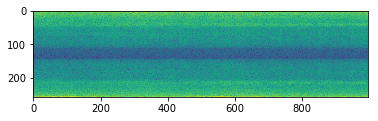

fs 189982-0-0-33.wav
47 :Loading file:  189982-0-0-33.wav  class:  air_conditioner
(257, 918)


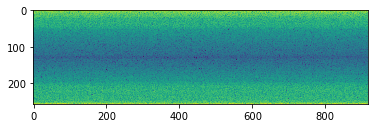

fs 159742-8-0-7.wav
fs 27070-2-0-7.wav
48 :Loading file:  27070-2-0-7.wav  class:  children_playing
(257, 918)


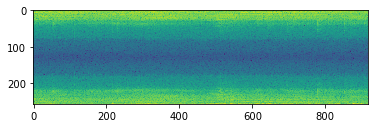

fs 15544-5-0-13.wav
fs 189982-0-0-30.wav
49 :Loading file:  189982-0-0-30.wav  class:  air_conditioner
(257, 918)


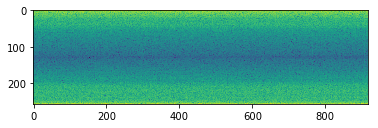

fs 7062-6-0-0.wav
50 :Loading file:  7062-6-0-0.wav  class:  gun_shot
(257, 313)


/opt/conda/lib/python3.6/site-packages/matplotlib/axes/_axes.py:7235: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:30: RuntimeWarning: divide by zero encountered in log


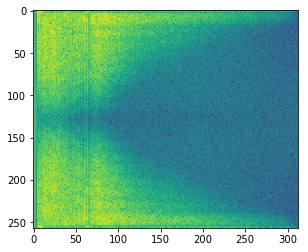

fs 200460-6-2-0.wav
51 :Loading file:  200460-6-2-0.wav  class:  gun_shot
(257, 197)


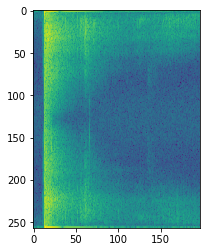

fs 181624-4-7-0.wav
fs 83191-9-0-0.wav
52 :Loading file:  83191-9-0-0.wav  class:  street_music
(257, 499)


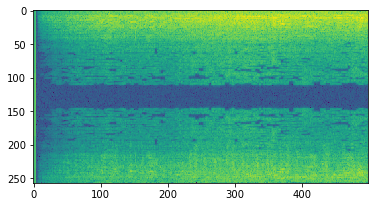

fs 83502-0-0-9.wav
53 :Loading file:  83502-0-0-9.wav  class:  air_conditioner
(257, 918)


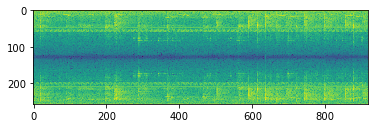

fs 167750-4-2-0.wav
fs 93567-8-0-10.wav
54 :Loading file:  93567-8-0-10.wav  class:  siren
(257, 918)


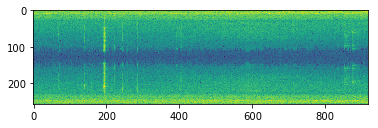

fs 14470-2-0-72.wav
55 :Loading file:  14470-2-0-72.wav  class:  children_playing
(257, 918)


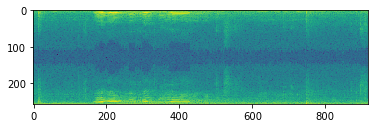

fs 102103-3-0-0.wav
56 :Loading file:  102103-3-0-0.wav  class:  dog_bark
(257, 121)


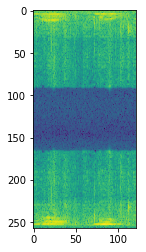

fs 209672-3-8-0.wav
57 :Loading file:  209672-3-8-0.wav  class:  dog_bark
(257, 240)


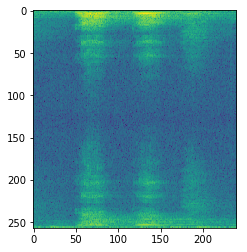

fs 136558-9-1-39.wav
fs 99192-4-0-49.wav
58 :Loading file:  99192-4-0-49.wav  class:  drilling
(257, 459)


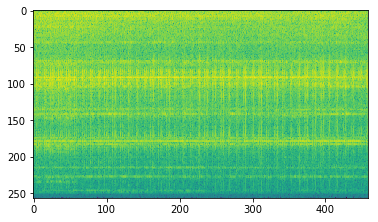

fs 189985-0-0-2.wav
59 :Loading file:  189985-0-0-2.wav  class:  air_conditioner
(257, 918)


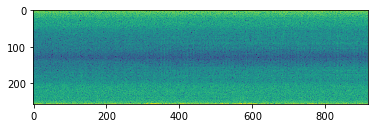

fs 157207-6-6-0.wav
60 :Loading file:  157207-6-6-0.wav  class:  gun_shot
(257, 289)


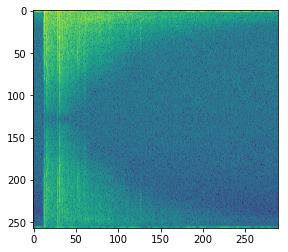

fs 197554-2-0-74.wav
fs 167464-0-0-17.wav
fs 39847-5-0-0.wav
61 :Loading file:  39847-5-0-0.wav  class:  engine_idling
(257, 918)


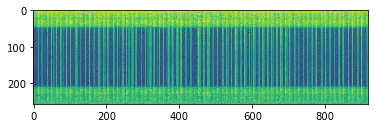

fs 188813-7-5-0.wav
fs 83502-0-0-6.wav
62 :Loading file:  83502-0-0-6.wav  class:  air_conditioner
(257, 918)


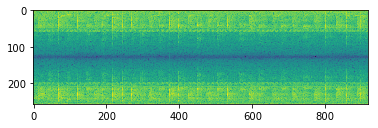

fs 69661-3-0-29.wav
63 :Loading file:  69661-3-0-29.wav  class:  dog_bark
(257, 918)


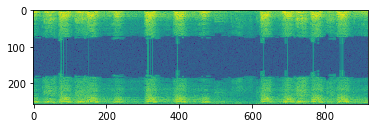

fs 24076-1-1-0.wav
64 :Loading file:  24076-1-1-0.wav  class:  car_horn
(257, 723)


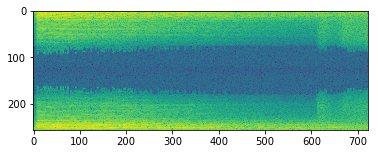

fs 188813-7-2-0.wav
fs 180127-4-0-7.wav
65 :Loading file:  180127-4-0-7.wav  class:  drilling
(257, 918)


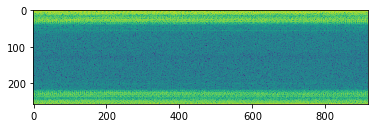

fs 162134-7-17-1.wav
fs 39847-5-0-5.wav
66 :Loading file:  39847-5-0-5.wav  class:  engine_idling
(257, 918)


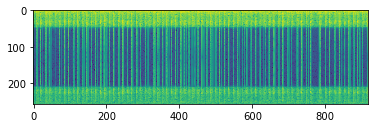

fs 128240-3-0-42.wav
fs 77901-9-0-2.wav
67 :Loading file:  77901-9-0-2.wav  class:  street_music
(257, 459)


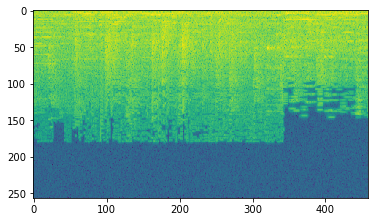

fs 128470-3-0-5.wav
fs 165166-8-0-4.wav
68 :Loading file:  165166-8-0-4.wav  class:  siren
(257, 918)


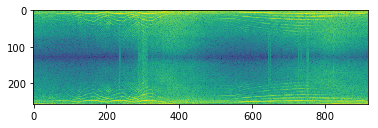

fs 15544-5-0-17.wav
fs 74364-8-1-4.wav
69 :Loading file:  74364-8-1-4.wav  class:  siren
(257, 918)


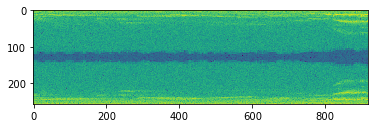

fs 77901-9-0-3.wav
70 :Loading file:  77901-9-0-3.wav  class:  street_music
(257, 459)


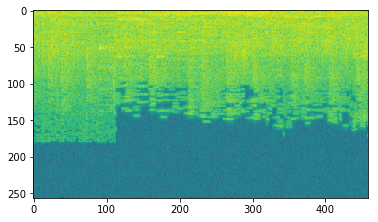

fs 39847-5-0-12.wav
71 :Loading file:  39847-5-0-12.wav  class:  engine_idling
(257, 918)


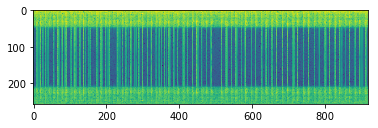

fs 93567-8-0-12.wav
72 :Loading file:  93567-8-0-12.wav  class:  siren
(257, 918)


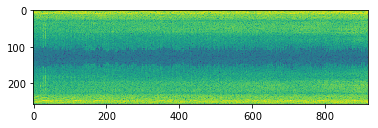

fs 102857-5-0-8.wav
73 :Loading file:  102857-5-0-8.wav  class:  engine_idling
(257, 918)


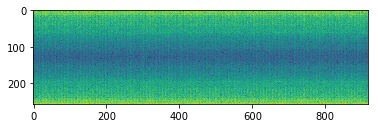

fs 128470-3-0-1.wav
fs 162134-7-0-0.wav
fs 165166-8-0-0.wav
74 :Loading file:  165166-8-0-0.wav  class:  siren
(257, 918)


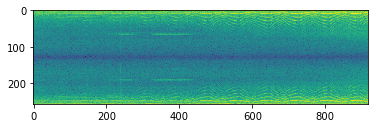

fs 196127-3-0-4.wav
fs 129750-2-0-36.wav
75 :Loading file:  129750-2-0-36.wav  class:  children_playing
(257, 918)


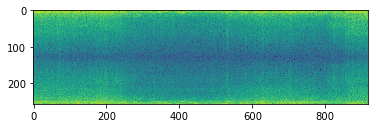

fs 209672-3-0-0.wav
76 :Loading file:  209672-3-0-0.wav  class:  dog_bark
(257, 348)


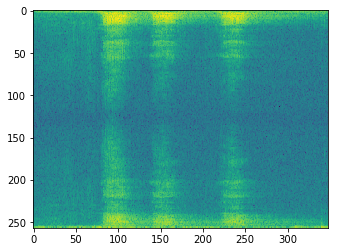

fs 26255-3-0-0.wav
77 :Loading file:  26255-3-0-0.wav  class:  dog_bark
(257, 56)


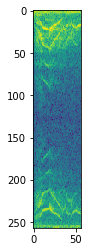

fs 99192-4-0-30.wav
78 :Loading file:  99192-4-0-30.wav  class:  drilling
(257, 459)


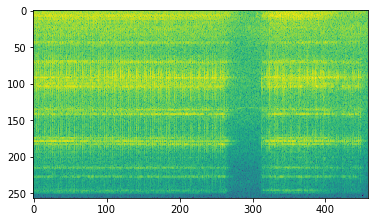

fs 22973-3-0-0.wav
79 :Loading file:  22973-3-0-0.wav  class:  dog_bark
(257, 918)


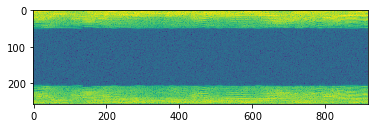

fs 59513-3-0-1.wav
80 :Loading file:  59513-3-0-1.wav  class:  dog_bark
(257, 918)


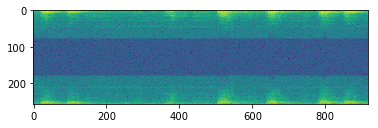

fs 162134-7-11-7.wav
fs 30344-3-0-3.wav
81 :Loading file:  30344-3-0-3.wav  class:  dog_bark
(257, 918)


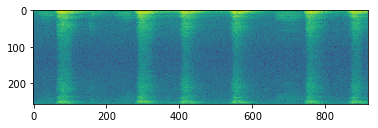

fs 73524-0-0-32.wav
82 :Loading file:  73524-0-0-32.wav  class:  air_conditioner
(257, 459)


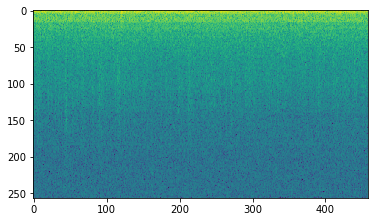

fs 162134-7-15-0.wav
fs 129750-2-0-3.wav
83 :Loading file:  129750-2-0-3.wav  class:  children_playing
(257, 918)


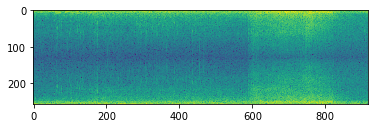

fs 189982-0-0-6.wav
84 :Loading file:  189982-0-0-6.wav  class:  air_conditioner
(257, 918)


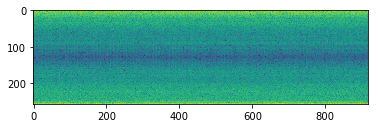

fs 54086-1-1-0.wav
85 :Loading file:  54086-1-1-0.wav  class:  car_horn
(257, 137)


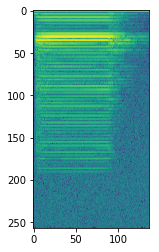

fs 195063-4-1-0.wav
86 :Loading file:  195063-4-1-0.wav  class:  drilling
(257, 459)


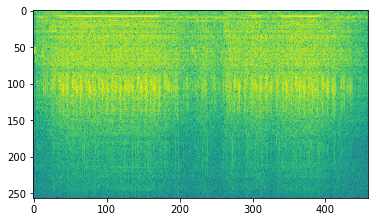

fs 99192-4-0-7.wav
87 :Loading file:  99192-4-0-7.wav  class:  drilling
(257, 459)


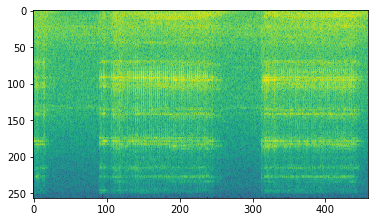

fs 118278-4-0-4.wav
88 :Loading file:  118278-4-0-4.wav  class:  drilling
(257, 999)


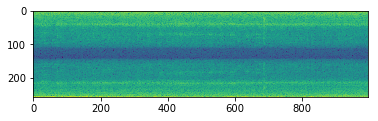

fs 162134-7-7-0.wav
fs 200786-5-1-4.wav
89 :Loading file:  200786-5-1-4.wav  class:  engine_idling
(257, 918)


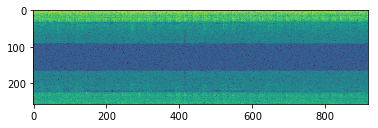

fs 178261-7-3-2.wav
fs 69661-3-0-23.wav
90 :Loading file:  69661-3-0-23.wav  class:  dog_bark
(257, 918)


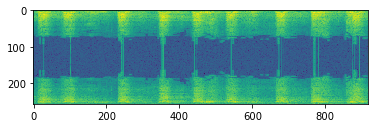

fs 162134-7-16-0.wav
fs 155280-2-0-5.wav
fs 34050-7-1-0.wav
91 :Loading file:  34050-7-1-0.wav  class:  jackhammer
(257, 316)


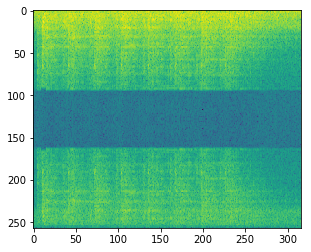

fs 196069-2-0-0.wav
92 :Loading file:  196069-2-0-0.wav  class:  children_playing
(257, 722)


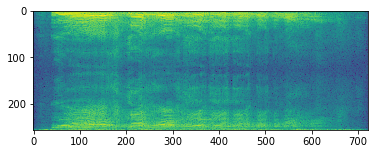

fs 72220-3-0-0.wav
93 :Loading file:  72220-3-0-0.wav  class:  dog_bark
(257, 697)


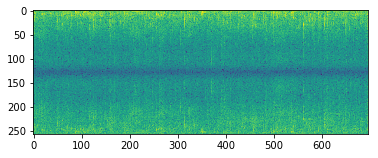

fs 17486-3-0-0.wav
94 :Loading file:  17486-3-0-0.wav  class:  dog_bark
(257, 148)


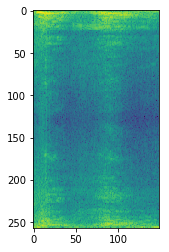

fs 27070-2-0-8.wav
95 :Loading file:  27070-2-0-8.wav  class:  children_playing
(257, 918)


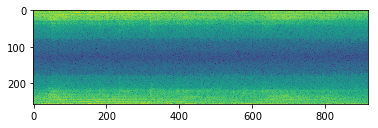

fs 34050-7-0-0.wav
96 :Loading file:  34050-7-0-0.wav  class:  jackhammer
(257, 803)


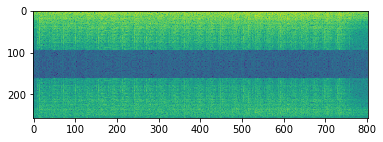

fs 88121-8-0-3.wav
97 :Loading file:  88121-8-0-3.wav  class:  siren
(257, 999)


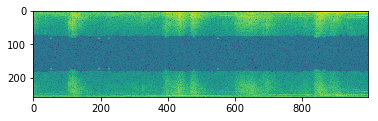

fs 74364-8-1-18.wav
98 :Loading file:  74364-8-1-18.wav  class:  siren
(257, 918)


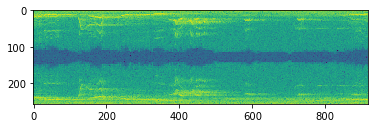

fs 180127-4-0-10.wav
99 :Loading file:  180127-4-0-10.wav  class:  drilling
(257, 918)


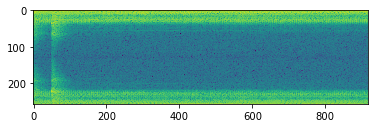

fs 99192-4-0-40.wav
100 :Loading file:  99192-4-0-40.wav  class:  drilling
(257, 459)


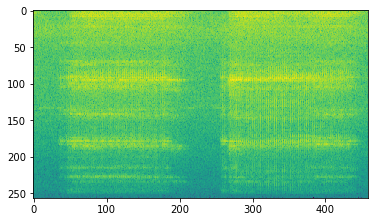

fs 167464-0-0-12.wav
fs 159742-8-0-13.wav
fs 15544-5-0-1.wav
fs 180127-4-0-18.wav
101 :Loading file:  180127-4-0-18.wav  class:  drilling
(257, 918)


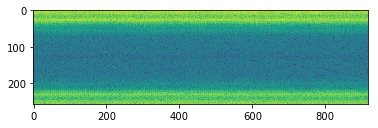

fs 199261-3-0-1.wav
fs 74364-8-1-24.wav
102 :Loading file:  74364-8-1-24.wav  class:  siren
(257, 918)


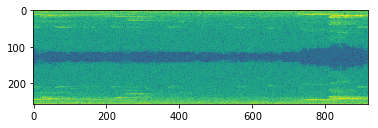

fs 162134-7-12-4.wav
fs 28808-1-1-0.wav
103 :Loading file:  28808-1-1-0.wav  class:  car_horn
(257, 918)


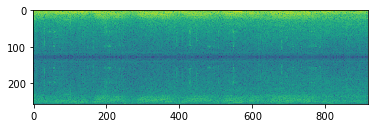

fs 93567-8-0-17.wav
104 :Loading file:  93567-8-0-17.wav  class:  siren
(257, 918)


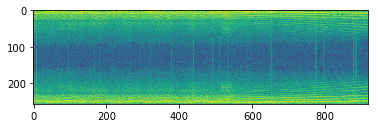

fs 73524-0-0-5.wav
105 :Loading file:  73524-0-0-5.wav  class:  air_conditioner
(257, 459)


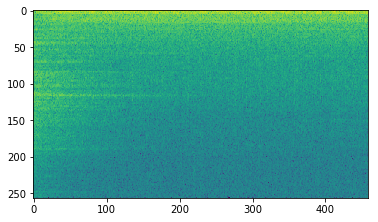

fs 178261-7-3-0.wav
fs 162134-7-13-3.wav
fs 118558-5-1-0.wav
106 :Loading file:  118558-5-1-0.wav  class:  engine_idling
(257, 459)


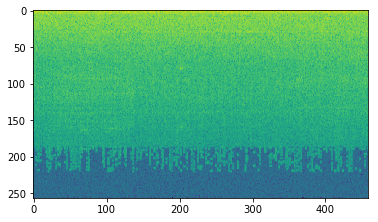

fs 155311-3-0-0.wav
107 :Loading file:  155311-3-0-0.wav  class:  dog_bark
(257, 105)


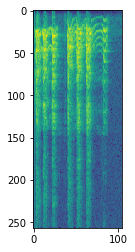

fs 73524-0-0-0.wav
108 :Loading file:  73524-0-0-0.wav  class:  air_conditioner
(257, 459)


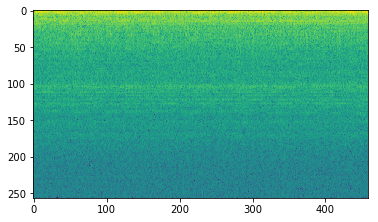

fs 167464-0-0-8.wav
fs 155262-2-0-48.wav
fs 34050-7-2-0.wav
109 :Loading file:  34050-7-2-0.wav  class:  jackhammer
(257, 330)


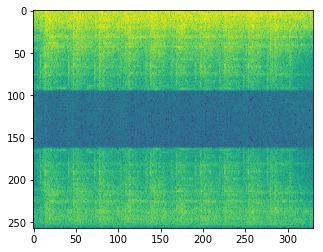

fs 162134-7-8-3.wav
fs 187863-4-0-5.wav
110 :Loading file:  187863-4-0-5.wav  class:  drilling
(257, 166)


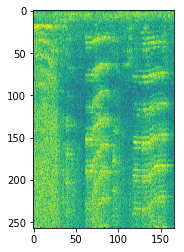

fs 181624-4-0-0.wav
fs 118278-4-0-1.wav
111 :Loading file:  118278-4-0-1.wav  class:  drilling
(257, 999)


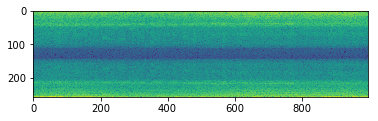

fs 72538-3-0-4.wav
112 :Loading file:  72538-3-0-4.wav  class:  dog_bark
(257, 229)


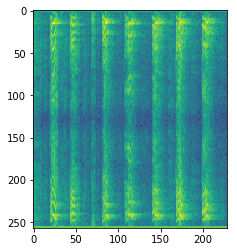

fs 180127-4-0-2.wav
113 :Loading file:  180127-4-0-2.wav  class:  drilling
(257, 918)


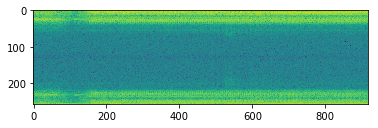

fs 99192-4-0-0.wav
114 :Loading file:  99192-4-0-0.wav  class:  drilling
(257, 459)


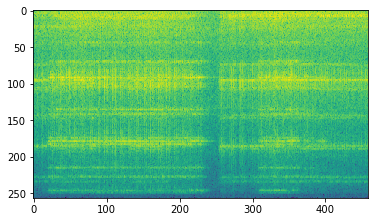

fs 188813-7-4-0.wav
fs 189982-0-0-44.wav
115 :Loading file:  189982-0-0-44.wav  class:  air_conditioner
(257, 918)


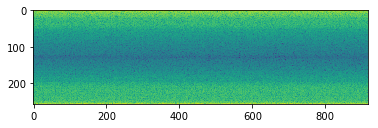

fs 188813-7-3-0.wav
fs 15544-5-0-9.wav
fs 162134-7-15-4.wav
fs 195063-4-0-0.wav
116 :Loading file:  195063-4-0-0.wav  class:  drilling
(257, 459)


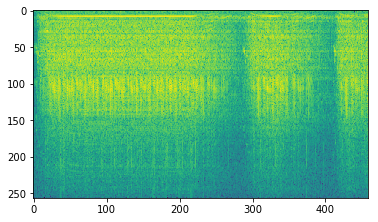

fs 71312-3-0-5.wav
117 :Loading file:  71312-3-0-5.wav  class:  dog_bark
(257, 918)


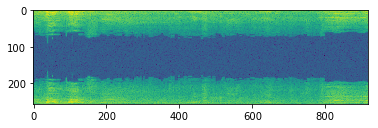

fs 199261-3-0-4.wav
fs 180127-4-0-8.wav
118 :Loading file:  180127-4-0-8.wav  class:  drilling
(257, 918)


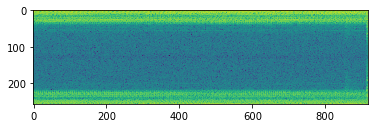

fs 102857-5-0-24.wav
119 :Loading file:  102857-5-0-24.wav  class:  engine_idling
(257, 918)


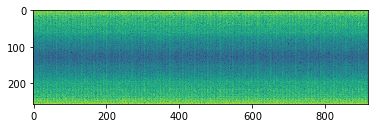

fs 180127-4-0-15.wav
120 :Loading file:  180127-4-0-15.wav  class:  drilling
(257, 918)


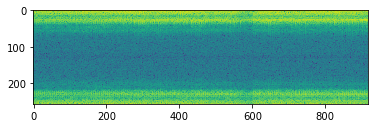

fs 30344-3-0-4.wav
121 :Loading file:  30344-3-0-4.wav  class:  dog_bark
(257, 918)


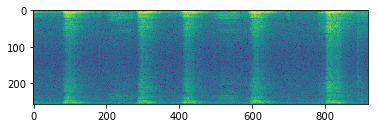

fs 83502-0-0-5.wav
122 :Loading file:  83502-0-0-5.wav  class:  air_conditioner
(257, 918)


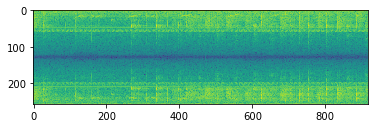

fs 39847-5-0-6.wav
123 :Loading file:  39847-5-0-6.wav  class:  engine_idling
(257, 918)


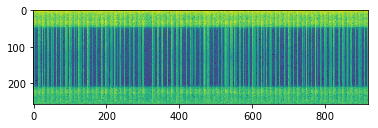

fs 180127-4-0-0.wav
124 :Loading file:  180127-4-0-0.wav  class:  drilling
(257, 918)


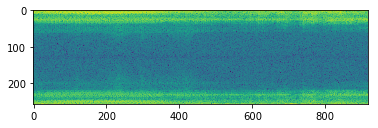

fs 99192-4-0-54.wav
125 :Loading file:  99192-4-0-54.wav  class:  drilling
(257, 459)


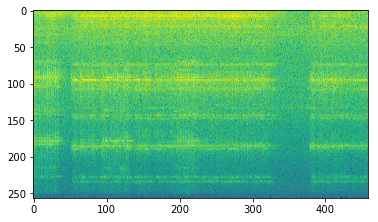

fs 155280-2-0-13.wav
fs 81791-3-1-0.wav
126 :Loading file:  81791-3-1-0.wav  class:  dog_bark
(257, 332)


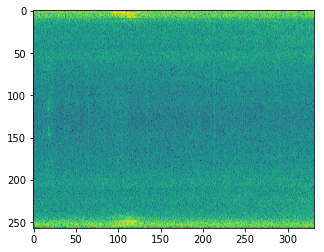

fs 188813-7-10-0.wav
fs 83502-0-0-0.wav
127 :Loading file:  83502-0-0-0.wav  class:  air_conditioner
(257, 918)


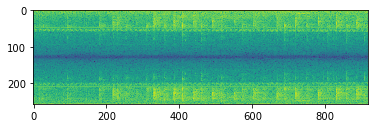

fs 102857-5-0-3.wav
128 :Loading file:  102857-5-0-3.wav  class:  engine_idling
(257, 918)


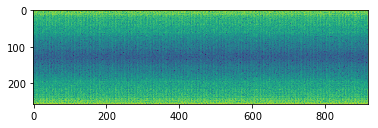

fs 162134-7-5-0.wav
fs 115241-9-0-9.wav
129 :Loading file:  115241-9-0-9.wav  class:  street_music
(257, 918)


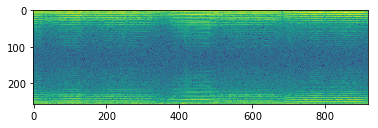

fs 147491-9-2-6.wav
fs 102857-5-0-1.wav
130 :Loading file:  102857-5-0-1.wav  class:  engine_idling
(257, 918)


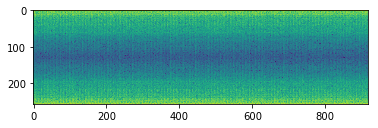

fs 74364-8-1-27.wav
131 :Loading file:  74364-8-1-27.wav  class:  siren
(257, 918)


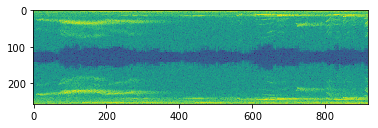

fs 181624-4-10-0.wav
fs 175842-1-0-0.wav
fs 162134-7-16-1.wav
fs 117889-9-0-20.wav
132 :Loading file:  117889-9-0-20.wav  class:  street_music
(257, 918)


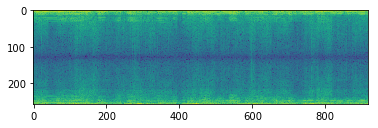

fs 73524-0-0-6.wav
133 :Loading file:  73524-0-0-6.wav  class:  air_conditioner
(257, 459)


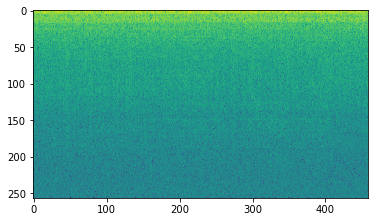

fs 200786-5-1-1.wav
134 :Loading file:  200786-5-1-1.wav  class:  engine_idling
(257, 918)


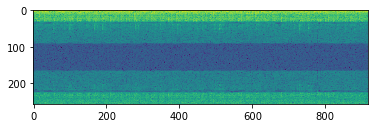

fs 162134-7-9-4.wav
fs 159742-8-0-14.wav
fs 100795-3-0-0.wav
135 :Loading file:  100795-3-0-0.wav  class:  dog_bark
(257, 918)


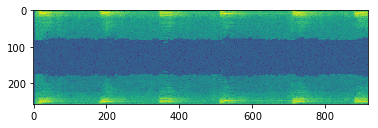

fs 159742-8-0-5.wav
fs 115418-9-0-6.wav
fs 157207-6-9-0.wav
136 :Loading file:  157207-6-9-0.wav  class:  gun_shot
(257, 479)


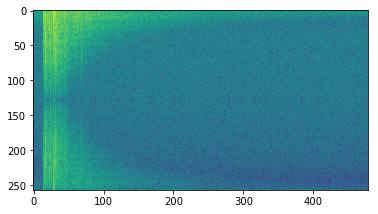

fs 14468-3-5-0.wav
137 :Loading file:  14468-3-5-0.wav  class:  dog_bark
(257, 918)


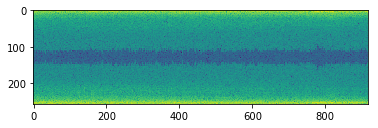

fs 118558-5-2-0.wav
138 :Loading file:  118558-5-2-0.wav  class:  engine_idling
(257, 459)


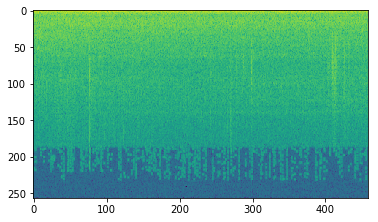

fs 188497-2-0-8.wav
fs 17074-1-0-0.wav
139 :Loading file:  17074-1-0-0.wav  class:  car_horn
(257, 197)


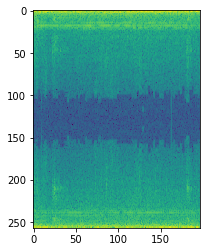

fs 129750-2-0-45.wav
140 :Loading file:  129750-2-0-45.wav  class:  children_playing
(257, 918)


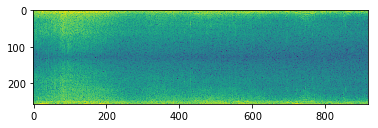

fs 118558-5-2-1.wav
141 :Loading file:  118558-5-2-1.wav  class:  engine_idling
(257, 459)


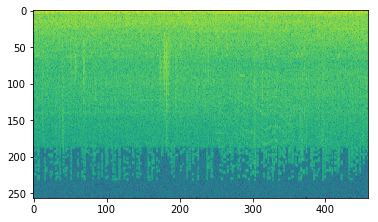

fs 106014-5-0-4.wav
fs 73524-0-0-92.wav
142 :Loading file:  73524-0-0-92.wav  class:  air_conditioner
(257, 459)


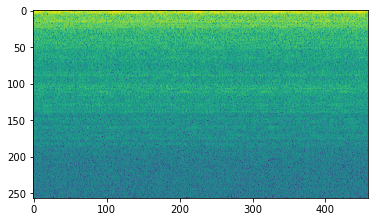

fs 197554-2-0-28.wav
fs 81791-3-0-1.wav
143 :Loading file:  81791-3-0-1.wav  class:  dog_bark
(257, 999)


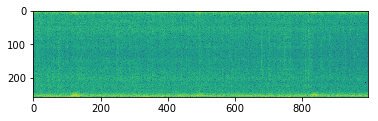

fs 136558-9-1-26.wav
fs 73524-0-0-114.wav
144 :Loading file:  73524-0-0-114.wav  class:  air_conditioner
(257, 459)


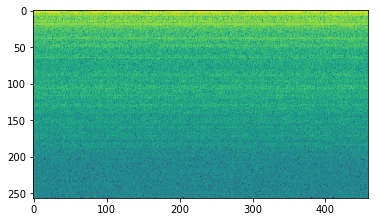

fs 71312-3-0-1.wav
145 :Loading file:  71312-3-0-1.wav  class:  dog_bark
(257, 918)


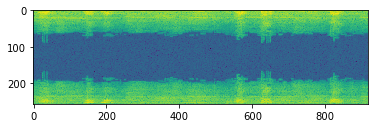

fs 102857-5-0-9.wav
146 :Loading file:  102857-5-0-9.wav  class:  engine_idling
(257, 918)


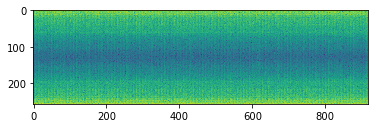

fs 162134-7-11-3.wav
fs 189982-0-0-28.wav
147 :Loading file:  189982-0-0-28.wav  class:  air_conditioner
(257, 918)


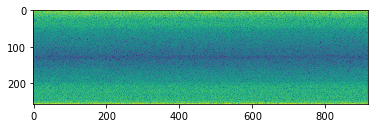

fs 27070-2-0-2.wav
148 :Loading file:  27070-2-0-2.wav  class:  children_playing
(257, 918)


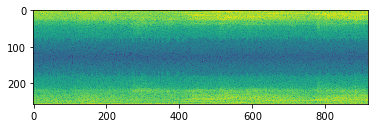

fs 180127-4-0-12.wav
149 :Loading file:  180127-4-0-12.wav  class:  drilling
(257, 918)


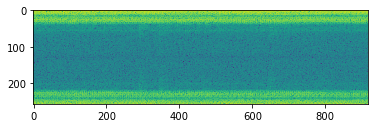

fs 73524-0-0-73.wav
150 :Loading file:  73524-0-0-73.wav  class:  air_conditioner
(257, 459)


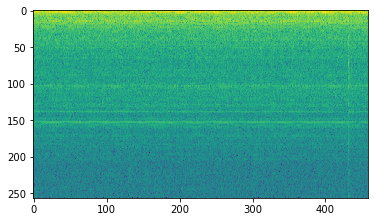

fs 197554-2-0-69.wav
fs 102857-5-0-15.wav
151 :Loading file:  102857-5-0-15.wav  class:  engine_idling
(257, 918)


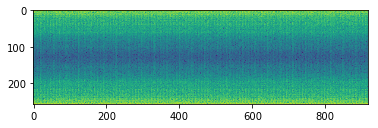

fs 189985-0-0-3.wav
152 :Loading file:  189985-0-0-3.wav  class:  air_conditioner
(257, 918)


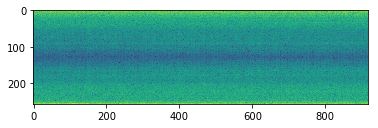

fs 178826-2-0-39.wav
153 :Loading file:  178826-2-0-39.wav  class:  children_playing
(257, 999)


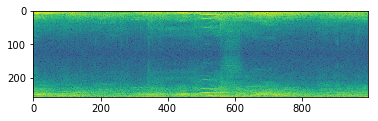

fs 102857-5-0-0.wav
154 :Loading file:  102857-5-0-0.wav  class:  engine_idling
(257, 918)


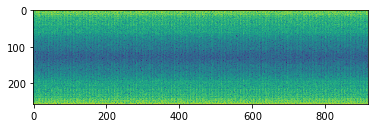

fs 101382-2-0-21.wav
155 :Loading file:  101382-2-0-21.wav  class:  children_playing
(257, 999)


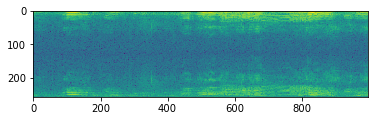

fs 187110-2-0-27.wav
156 :Loading file:  187110-2-0-27.wav  class:  children_playing
(257, 918)


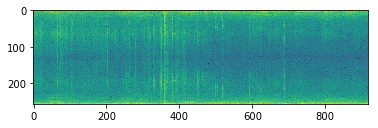

fs 172519-9-0-53.wav
fs 7965-3-16-0.wav
157 :Loading file:  7965-3-16-0.wav  class:  dog_bark
(257, 431)


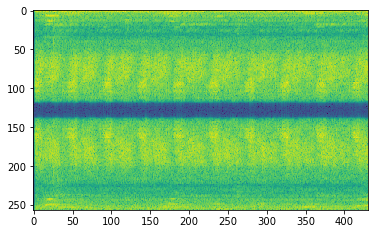

fs 15544-5-0-19.wav
fs 180127-4-0-17.wav
158 :Loading file:  180127-4-0-17.wav  class:  drilling
(257, 918)


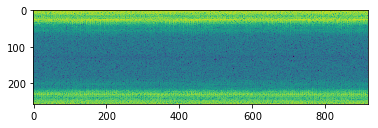

fs 39847-5-0-10.wav
159 :Loading file:  39847-5-0-10.wav  class:  engine_idling
(257, 918)


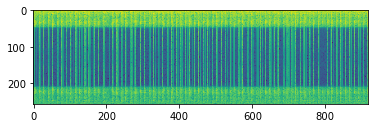

fs 73524-0-0-2.wav
160 :Loading file:  73524-0-0-2.wav  class:  air_conditioner
(257, 459)


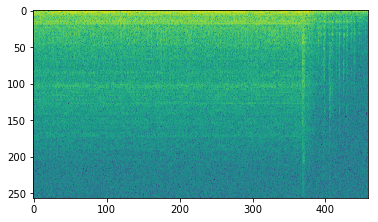

fs 51024-3-0-16.wav
161 :Loading file:  51024-3-0-16.wav  class:  dog_bark
(257, 918)


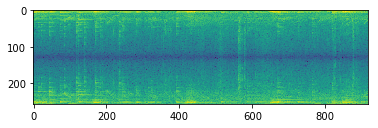

fs 41306-3-0-10.wav
162 :Loading file:  41306-3-0-10.wav  class:  dog_bark
(257, 918)


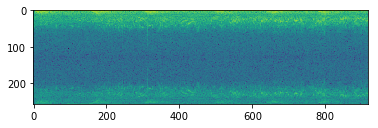

fs 199261-3-0-0.wav
fs 178826-2-0-17.wav
163 :Loading file:  178826-2-0-17.wav  class:  children_playing
(257, 999)


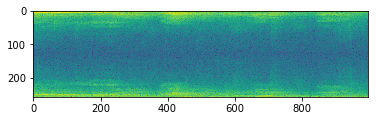

fs 162134-7-8-1.wav
fs 196084-2-0-1.wav
164 :Loading file:  196084-2-0-1.wav  class:  children_playing
(257, 918)


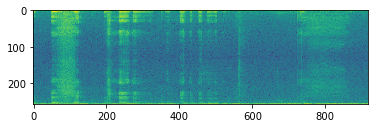

fs 162134-7-2-0.wav
fs 188813-7-8-0.wav
fs 84249-9-0-10.wav
165 :Loading file:  84249-9-0-10.wav  class:  street_music
(257, 499)


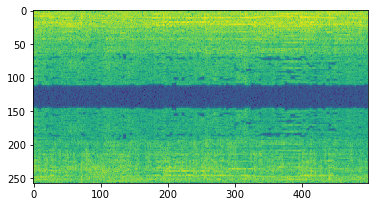

fs 167464-0-0-24.wav
fs 101382-2-0-33.wav
166 :Loading file:  101382-2-0-33.wav  class:  children_playing
(257, 999)


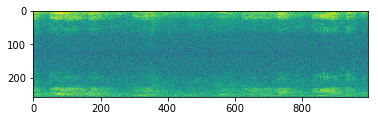

fs 162134-7-17-0.wav
fs 189982-0-0-45.wav
167 :Loading file:  189982-0-0-45.wav  class:  air_conditioner
(257, 918)


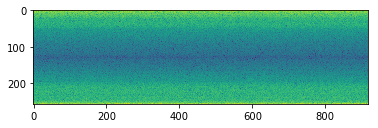

fs 74922-4-0-0.wav
fs 118558-5-2-2.wav
168 :Loading file:  118558-5-2-2.wav  class:  engine_idling
(257, 459)


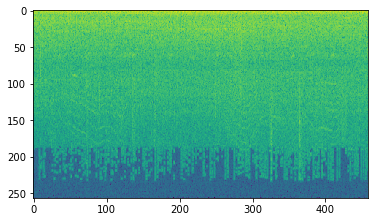

fs 147491-9-2-25.wav
fs 189982-0-0-3.wav
169 :Loading file:  189982-0-0-3.wav  class:  air_conditioner
(257, 918)


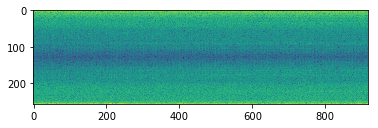

fs 118278-4-0-5.wav
170 :Loading file:  118278-4-0-5.wav  class:  drilling
(257, 999)


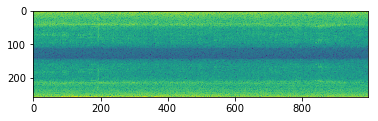

fs 141240-5-0-0.wav
fs 167464-0-0-3.wav
fs 155280-2-0-6.wav
fs 164194-2-0-26.wav
fs 196086-2-0-0.wav
171 :Loading file:  196086-2-0-0.wav  class:  children_playing
(257, 240)


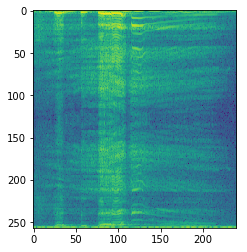

fs 200460-6-3-0.wav
172 :Loading file:  200460-6-3-0.wav  class:  gun_shot
(257, 286)


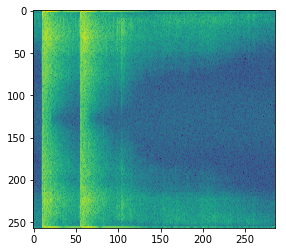

fs 181624-4-9-0.wav
fs 7965-3-22-0.wav
173 :Loading file:  7965-3-22-0.wav  class:  dog_bark
(257, 671)


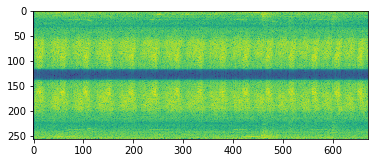

fs 100648-1-3-0.wav
174 :Loading file:  100648-1-3-0.wav  class:  car_horn
(257, 371)


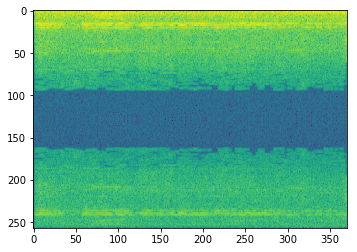

fs 84249-9-0-3.wav
175 :Loading file:  84249-9-0-3.wav  class:  street_music
(257, 499)


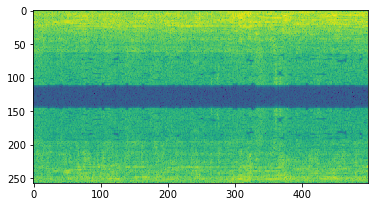

fs 74364-8-1-7.wav
176 :Loading file:  74364-8-1-7.wav  class:  siren
(257, 918)


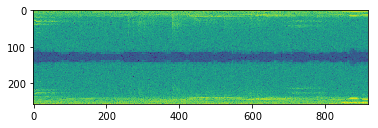

fs 115418-9-0-15.wav
fs 15544-5-0-2.wav
fs 178261-7-3-6.wav
fs 128240-3-0-39.wav
fs 159742-8-0-12.wav
fs 100795-3-1-1.wav
177 :Loading file:  100795-3-1-1.wav  class:  dog_bark
(257, 918)


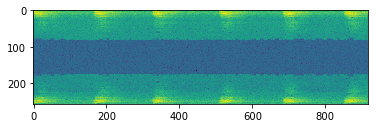

fs 73524-0-0-30.wav
178 :Loading file:  73524-0-0-30.wav  class:  air_conditioner
(257, 459)


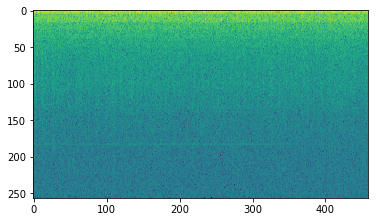

fs 119067-0-0-2.wav
fs 73524-0-0-98.wav
179 :Loading file:  73524-0-0-98.wav  class:  air_conditioner
(257, 459)


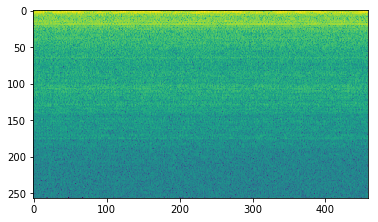

fs 162134-7-8-0.wav
fs 15544-5-0-4.wav
fs 93567-8-0-16.wav
180 :Loading file:  93567-8-0-16.wav  class:  siren
(257, 918)


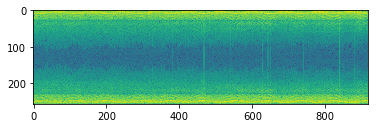

fs 73524-0-0-113.wav
181 :Loading file:  73524-0-0-113.wav  class:  air_conditioner
(257, 459)


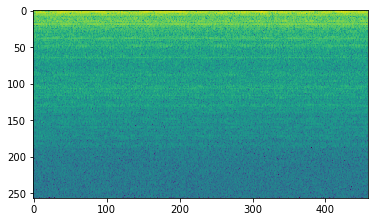

fs 102857-5-0-23.wav
182 :Loading file:  102857-5-0-23.wav  class:  engine_idling
(257, 918)


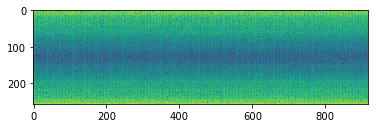

fs 162134-7-0-1.wav
fs 74922-4-0-1.wav
fs 73524-0-0-99.wav
183 :Loading file:  73524-0-0-99.wav  class:  air_conditioner
(257, 459)


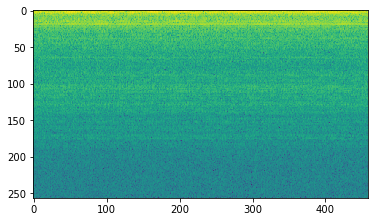

fs 74364-8-1-8.wav
184 :Loading file:  74364-8-1-8.wav  class:  siren
(257, 918)


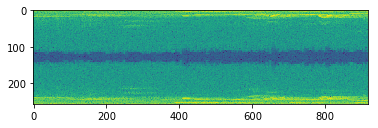

fs 159742-8-0-8.wav
fs 162134-7-9-1.wav
fs 142641-3-0-0.wav
185 :Loading file:  142641-3-0-0.wav  class:  dog_bark
(257, 43)


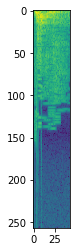

fs 189982-0-0-4.wav
186 :Loading file:  189982-0-0-4.wav  class:  air_conditioner
(257, 918)


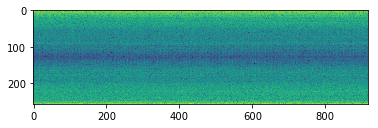

fs 155280-2-0-3.wav
fs 162134-7-12-0.wav
fs 74364-8-1-17.wav
187 :Loading file:  74364-8-1-17.wav  class:  siren
(257, 918)


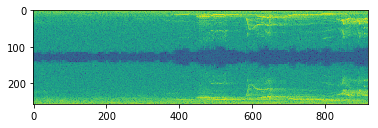

fs 77901-9-0-1.wav
188 :Loading file:  77901-9-0-1.wav  class:  street_music
(257, 459)


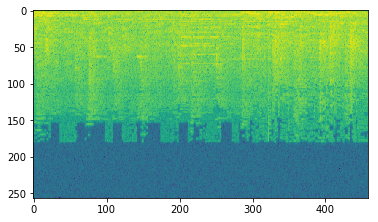

fs 200460-6-4-0.wav
189 :Loading file:  200460-6-4-0.wav  class:  gun_shot
(257, 196)


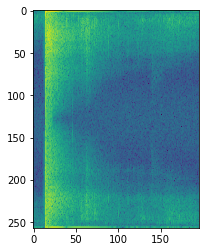

fs 77901-9-0-6.wav
190 :Loading file:  77901-9-0-6.wav  class:  street_music
(257, 459)


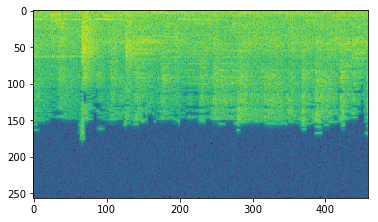

fs 155262-2-0-15.wav
fs 99192-4-0-3.wav
191 :Loading file:  99192-4-0-3.wav  class:  drilling
(257, 459)


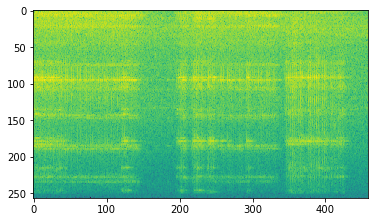

fs 93567-8-0-0.wav
192 :Loading file:  93567-8-0-0.wav  class:  siren
(257, 918)


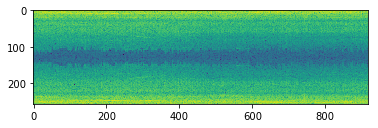

fs 101382-2-0-42.wav
193 :Loading file:  101382-2-0-42.wav  class:  children_playing
(257, 999)


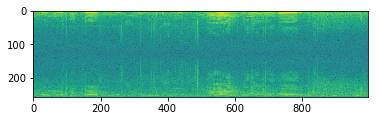

fs 73524-0-0-128.wav
194 :Loading file:  73524-0-0-128.wav  class:  air_conditioner
(257, 459)


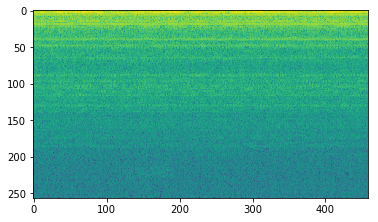

fs 165166-8-0-6.wav
195 :Loading file:  165166-8-0-6.wav  class:  siren
(257, 918)


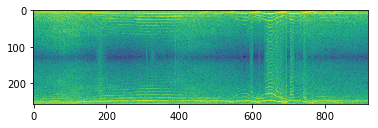

fs 39847-5-0-3.wav
196 :Loading file:  39847-5-0-3.wav  class:  engine_idling
(257, 918)


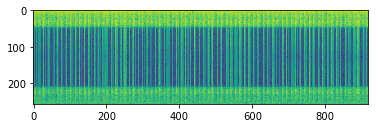

fs 15544-5-0-5.wav
fs 85574-3-0-0.wav
197 :Loading file:  85574-3-0-0.wav  class:  dog_bark
(257, 499)


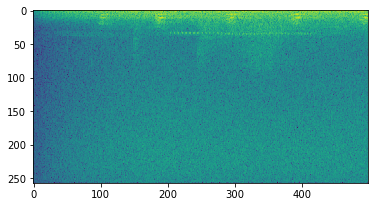

fs 15544-5-0-15.wav
fs 118558-5-1-1.wav
198 :Loading file:  118558-5-1-1.wav  class:  engine_idling
(257, 459)


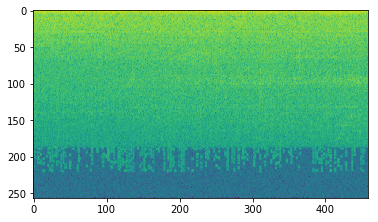

fs 164194-2-0-18.wav
fs 14470-2-0-21.wav
199 :Loading file:  14470-2-0-21.wav  class:  children_playing
(257, 918)


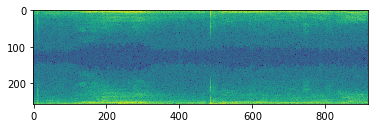

fs 99192-4-0-18.wav
200 :Loading file:  99192-4-0-18.wav  class:  drilling
(257, 459)


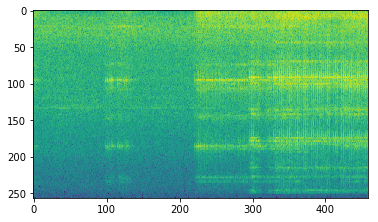

fs 77901-9-0-4.wav
201 :Loading file:  77901-9-0-4.wav  class:  street_music
(257, 459)


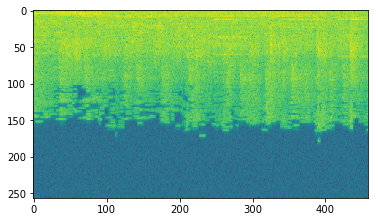

fs 202334-9-0-202.wav
fs 71312-3-0-4.wav
202 :Loading file:  71312-3-0-4.wav  class:  dog_bark
(257, 918)


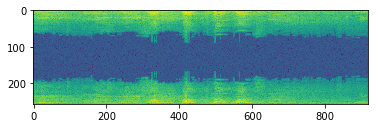

fs 118278-4-0-13.wav
203 :Loading file:  118278-4-0-13.wav  class:  drilling
(257, 999)


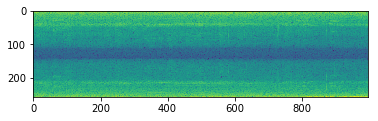

fs 164377-9-0-16.wav
fs 102857-5-0-25.wav
204 :Loading file:  102857-5-0-25.wav  class:  engine_idling
(257, 918)


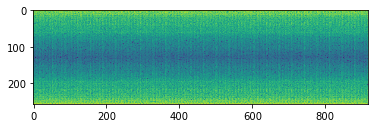

fs 99192-4-0-33.wav
205 :Loading file:  99192-4-0-33.wav  class:  drilling
(257, 459)


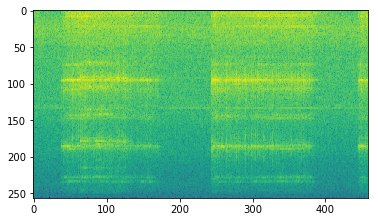

fs 15544-5-0-0.wav
fs 7913-3-0-0.wav
206 :Loading file:  7913-3-0-0.wav  class:  dog_bark
(257, 228)


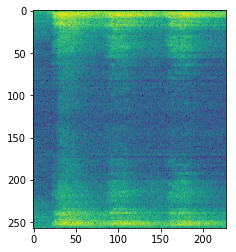

fs 129750-2-0-34.wav
207 :Loading file:  129750-2-0-34.wav  class:  children_playing
(257, 918)


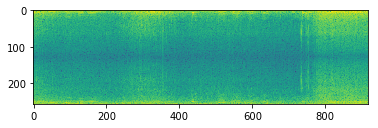

fs 138017-9-1-16.wav
208 :Loading file:  138017-9-1-16.wav  class:  street_music
(257, 918)


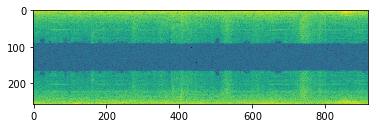

fs 102857-5-0-29.wav
209 :Loading file:  102857-5-0-29.wav  class:  engine_idling
(257, 918)


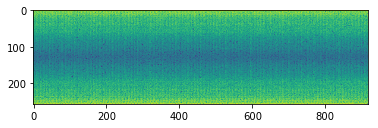

fs 74922-4-0-5.wav
fs 34050-7-5-0.wav
210 :Loading file:  34050-7-5-0.wav  class:  jackhammer
(257, 504)


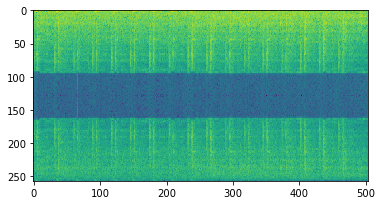

fs 83191-9-0-4.wav
211 :Loading file:  83191-9-0-4.wav  class:  street_music
(257, 499)


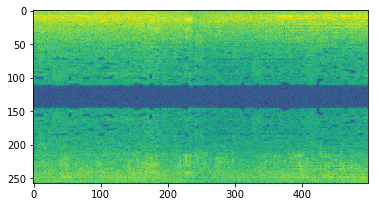

fs 74364-8-1-2.wav
212 :Loading file:  74364-8-1-2.wav  class:  siren
(257, 918)


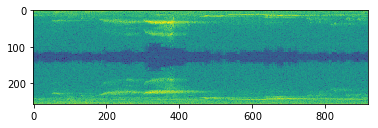

fs 20571-3-0-0.wav
213 :Loading file:  20571-3-0-0.wav  class:  dog_bark
(257, 676)


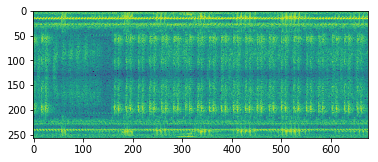

fs 165166-8-0-8.wav
214 :Loading file:  165166-8-0-8.wav  class:  siren
(257, 918)


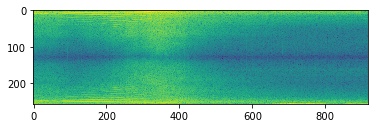

fs 187110-2-0-30.wav
215 :Loading file:  187110-2-0-30.wav  class:  children_playing
(257, 918)


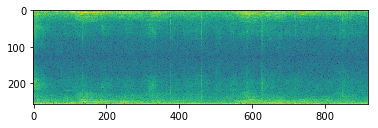

fs 77927-3-0-1.wav
216 :Loading file:  77927-3-0-1.wav  class:  dog_bark
(257, 918)


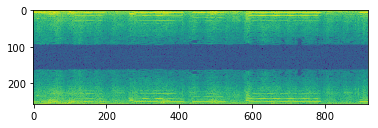

fs 167464-0-0-13.wav
fs 85574-3-0-12.wav
217 :Loading file:  85574-3-0-12.wav  class:  dog_bark
(257, 499)


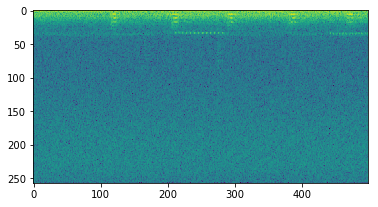

fs 84249-9-0-11.wav
218 :Loading file:  84249-9-0-11.wav  class:  street_music
(257, 499)


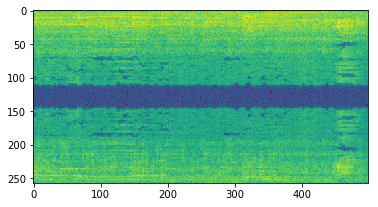

fs 180127-4-0-6.wav
219 :Loading file:  180127-4-0-6.wav  class:  drilling
(257, 918)


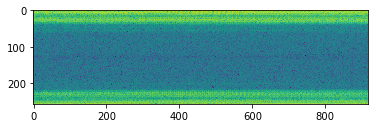

fs 207213-2-0-41.wav
fs 11722-3-1-0.wav
fs 172519-9-0-8.wav
fs 115241-9-0-8.wav
220 :Loading file:  115241-9-0-8.wav  class:  street_music
(257, 918)


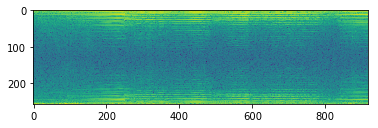

fs 189982-0-0-38.wav
221 :Loading file:  189982-0-0-38.wav  class:  air_conditioner
(257, 918)


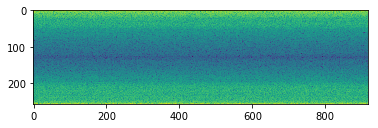

fs 188813-7-10-1.wav
fs 118278-4-0-8.wav
222 :Loading file:  118278-4-0-8.wav  class:  drilling
(257, 999)


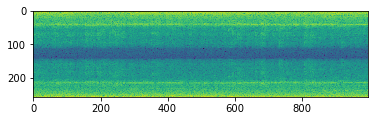

fs 25037-6-1-0.wav
223 :Loading file:  25037-6-1-0.wav  class:  gun_shot
(257, 304)


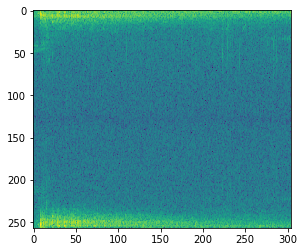

fs 200786-5-1-5.wav
224 :Loading file:  200786-5-1-5.wav  class:  engine_idling
(257, 918)


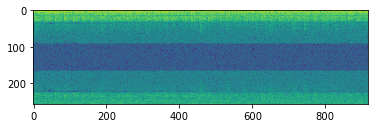

fs 85574-3-0-2.wav
225 :Loading file:  85574-3-0-2.wav  class:  dog_bark
(257, 499)


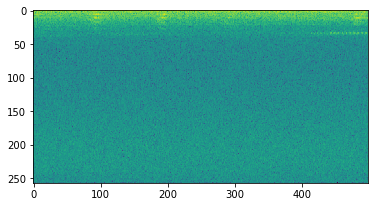

fs 83195-9-0-14.wav
226 :Loading file:  83195-9-0-14.wav  class:  street_music
(257, 499)


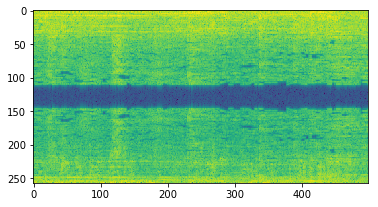

fs 17486-3-1-0.wav
227 :Loading file:  17486-3-1-0.wav  class:  dog_bark
(257, 295)


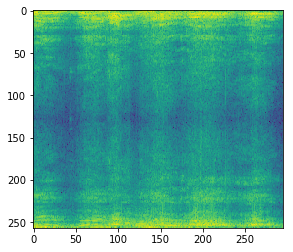

fs 115241-9-0-6.wav
228 :Loading file:  115241-9-0-6.wav  class:  street_music
(257, 918)


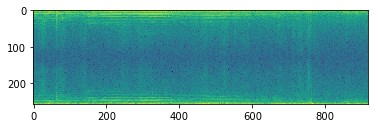

fs 102857-5-0-22.wav
229 :Loading file:  102857-5-0-22.wav  class:  engine_idling
(257, 918)


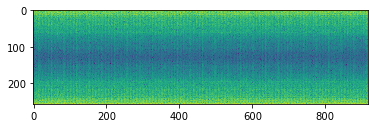

fs 72538-3-0-0.wav
230 :Loading file:  72538-3-0-0.wav  class:  dog_bark
(257, 229)


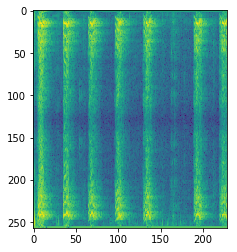

fs 84249-9-0-7.wav
231 :Loading file:  84249-9-0-7.wav  class:  street_music
(257, 499)


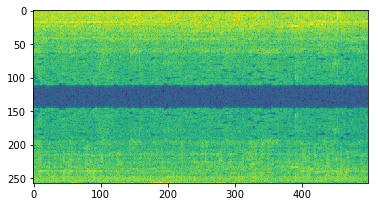

fs 54086-1-0-0.wav
232 :Loading file:  54086-1-0-0.wav  class:  car_horn
(257, 132)


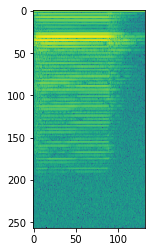

fs 15544-5-0-6.wav
fs 178261-7-3-1.wav
fs 102857-5-0-14.wav
233 :Loading file:  102857-5-0-14.wav  class:  engine_idling
(257, 918)


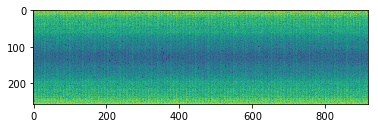

fs 34050-7-3-0.wav
234 :Loading file:  34050-7-3-0.wav  class:  jackhammer
(257, 433)


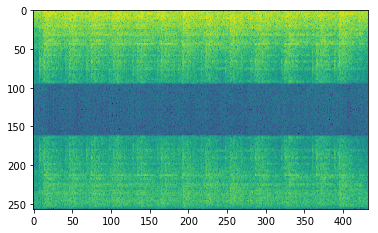

fs 207213-2-0-73.wav
fs 93567-8-0-15.wav
235 :Loading file:  93567-8-0-15.wav  class:  siren
(257, 918)


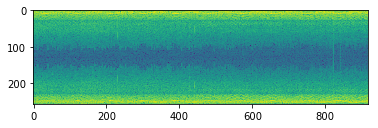

fs 162134-7-7-1.wav
fs 73524-0-0-31.wav
236 :Loading file:  73524-0-0-31.wav  class:  air_conditioner
(257, 459)


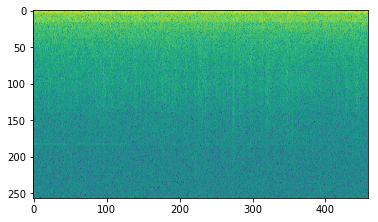

fs 162148-3-0-0.wav
fs 26344-4-1-0.wav
237 :Loading file:  26344-4-1-0.wav  class:  drilling
(257, 606)


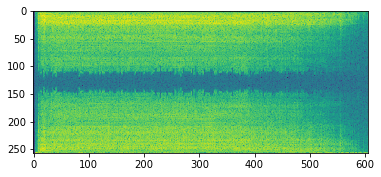

fs 102857-5-0-17.wav
238 :Loading file:  102857-5-0-17.wav  class:  engine_idling
(257, 918)


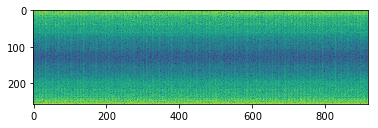

fs 23218-5-0-0.wav
239 :Loading file:  23218-5-0-0.wav  class:  engine_idling
(257, 379)


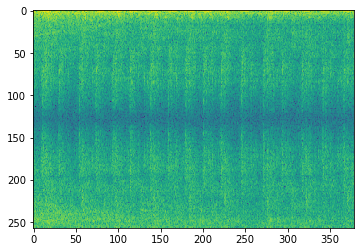

fs 167464-0-0-9.wav
fs 99192-4-0-26.wav
240 :Loading file:  99192-4-0-26.wav  class:  drilling
(257, 459)


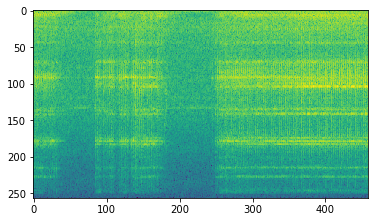

fs 88121-8-0-2.wav
241 :Loading file:  88121-8-0-2.wav  class:  siren
(257, 999)


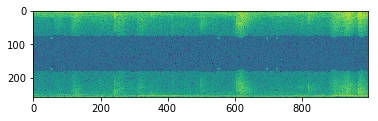

fs 102857-5-0-30.wav
242 :Loading file:  102857-5-0-30.wav  class:  engine_idling
(257, 918)


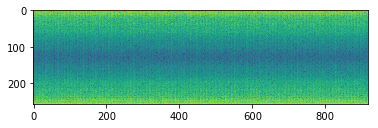

fs 189982-0-0-7.wav
243 :Loading file:  189982-0-0-7.wav  class:  air_conditioner
(257, 918)


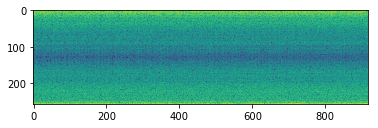

fs 39847-5-0-8.wav
244 :Loading file:  39847-5-0-8.wav  class:  engine_idling
(257, 918)


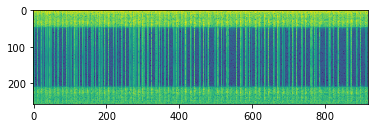

fs 15544-5-0-14.wav
fs 159709-6-0-0.wav
fs 197554-2-0-60.wav
fs 128240-3-0-20.wav
fs 59513-3-0-4.wav
245 :Loading file:  59513-3-0-4.wav  class:  dog_bark
(257, 918)


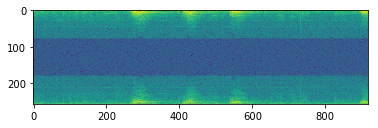

fs 119067-0-0-1.wav
fs 14470-2-0-4.wav
246 :Loading file:  14470-2-0-4.wav  class:  children_playing
(257, 918)


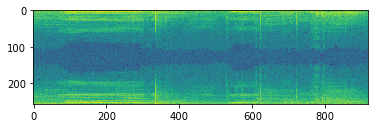

fs 187110-2-0-6.wav
247 :Loading file:  187110-2-0-6.wav  class:  children_playing
(257, 918)


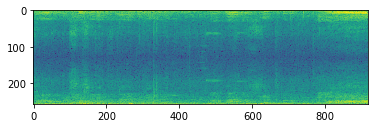

fs 162134-7-11-6.wav
fs 162134-7-11-2.wav
fs 163459-3-0-0.wav
fs 189985-0-0-4.wav
248 :Loading file:  189985-0-0-4.wav  class:  air_conditioner
(257, 918)


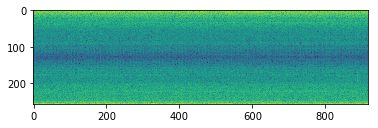

fs 178826-2-0-20.wav
249 :Loading file:  178826-2-0-20.wav  class:  children_playing
(257, 999)


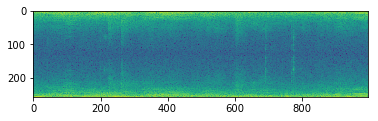

fs 162134-7-17-2.wav
fs 14470-2-0-10.wav
250 :Loading file:  14470-2-0-10.wav  class:  children_playing
(257, 918)


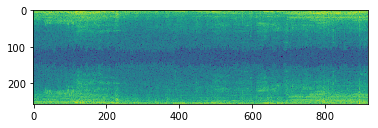

fs 93567-8-0-19.wav
251 :Loading file:  93567-8-0-19.wav  class:  siren
(257, 918)


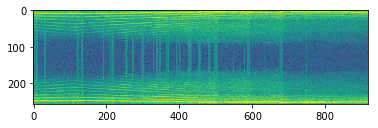

fs 26344-4-0-0.wav
252 :Loading file:  26344-4-0-0.wav  class:  drilling
(257, 667)


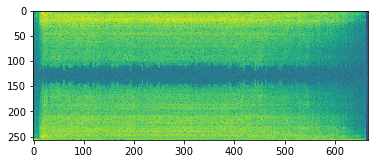

fs 162134-7-11-5.wav
fs 17124-1-0-0.wav
253 :Loading file:  17124-1-0-0.wav  class:  car_horn
(257, 54)


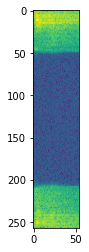

fs 174289-6-1-0.wav
254 :Loading file:  174289-6-1-0.wav  class:  gun_shot
(257, 586)


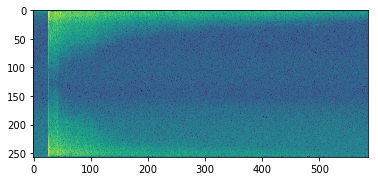

fs 28808-1-0-8.wav
255 :Loading file:  28808-1-0-8.wav  class:  car_horn
(257, 918)


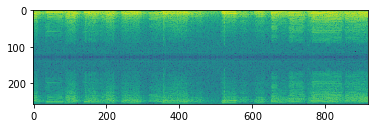

fs 83502-0-0-10.wav
256 :Loading file:  83502-0-0-10.wav  class:  air_conditioner
(257, 918)


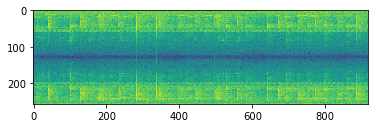

fs 74364-8-1-20.wav
257 :Loading file:  74364-8-1-20.wav  class:  siren
(257, 918)


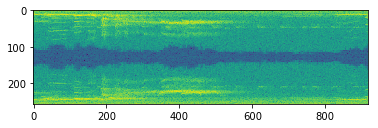

fs 174289-6-2-0.wav
258 :Loading file:  174289-6-2-0.wav  class:  gun_shot
(257, 614)


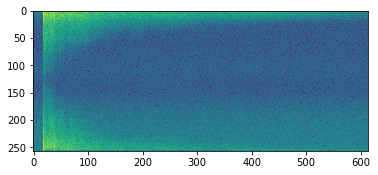

fs 188813-7-6-0.wav
fs 102857-5-0-4.wav
259 :Loading file:  102857-5-0-4.wav  class:  engine_idling
(257, 918)


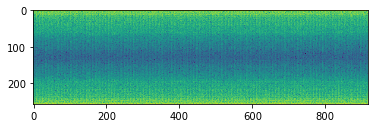

fs 162134-7-14-1.wav
fs 159742-8-0-4.wav
fs 28808-1-0-11.wav
260 :Loading file:  28808-1-0-11.wav  class:  car_horn
(257, 918)


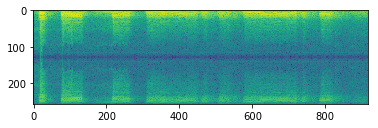

fs 118278-4-0-2.wav
261 :Loading file:  118278-4-0-2.wav  class:  drilling
(257, 999)


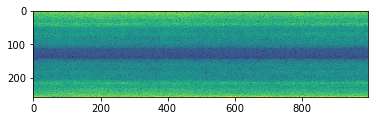

fs 83191-9-0-6.wav
262 :Loading file:  83191-9-0-6.wav  class:  street_music
(257, 499)


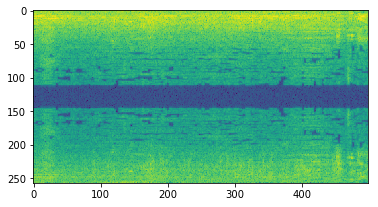

fs 188497-2-0-17.wav
fs 181624-4-3-0.wav
fs 83191-9-0-13.wav
263 :Loading file:  83191-9-0-13.wav  class:  street_music
(257, 499)


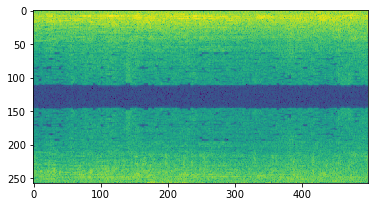

fs 188813-7-11-0.wav
fs 28808-1-0-3.wav
264 :Loading file:  28808-1-0-3.wav  class:  car_horn
(257, 918)


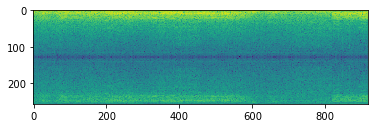

fs 174292-6-0-0.wav
265 :Loading file:  174292-6-0-0.wav  class:  gun_shot
(257, 732)


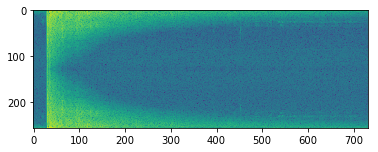

fs 117889-9-0-39.wav
266 :Loading file:  117889-9-0-39.wav  class:  street_music
(257, 918)


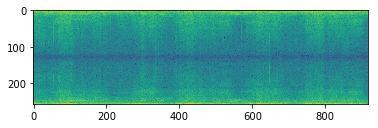

fs 162134-7-14-0.wav
fs 187863-4-0-2.wav
267 :Loading file:  187863-4-0-2.wav  class:  drilling
(257, 166)


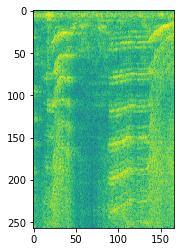

fs 99192-4-0-43.wav
268 :Loading file:  99192-4-0-43.wav  class:  drilling
(257, 459)


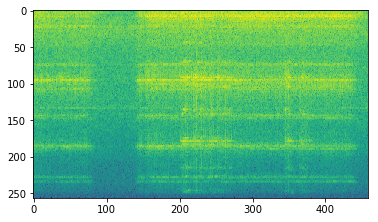

fs 138017-9-0-2.wav
269 :Loading file:  138017-9-0-2.wav  class:  street_music
(257, 918)


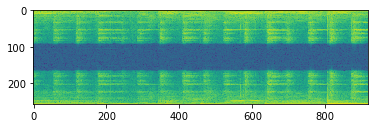

fs 162134-7-8-7.wav
fs 66115-1-0-1.wav
270 :Loading file:  66115-1-0-1.wav  class:  car_horn
(257, 918)


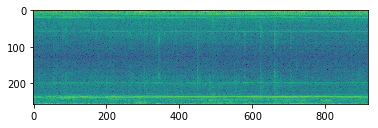

fs 106014-5-0-3.wav
fs 34050-7-6-0.wav
271 :Loading file:  34050-7-6-0.wav  class:  jackhammer
(257, 918)


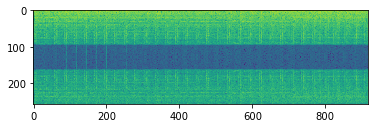

fs 26255-3-13-1.wav
272 :Loading file:  26255-3-13-1.wav  class:  dog_bark
(257, 918)


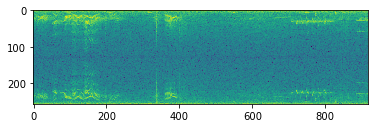

fs 7965-3-11-0.wav
273 :Loading file:  7965-3-11-0.wav  class:  dog_bark
(257, 309)


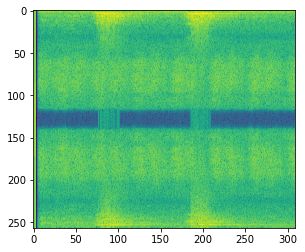

fs 102857-5-0-12.wav
274 :Loading file:  102857-5-0-12.wav  class:  engine_idling
(257, 918)


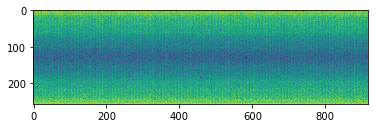

fs 178826-2-0-28.wav
275 :Loading file:  178826-2-0-28.wav  class:  children_playing
(257, 999)


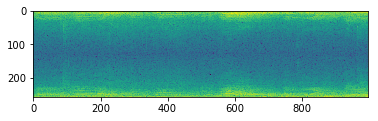

fs 2937-1-0-0.wav
276 :Loading file:  2937-1-0-0.wav  class:  car_horn
(257, 107)


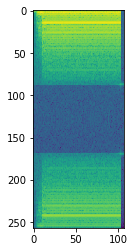

fs 172519-9-0-10.wav
fs 164194-2-0-11.wav
fs 59513-3-0-0.wav
277 :Loading file:  59513-3-0-0.wav  class:  dog_bark
(257, 918)


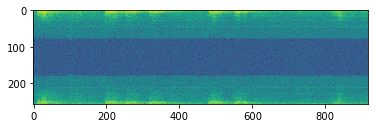

fs 84249-9-0-8.wav
278 :Loading file:  84249-9-0-8.wav  class:  street_music
(257, 499)


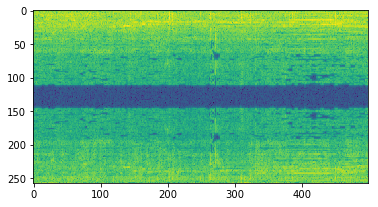

fs 39847-5-0-9.wav
279 :Loading file:  39847-5-0-9.wav  class:  engine_idling
(257, 918)


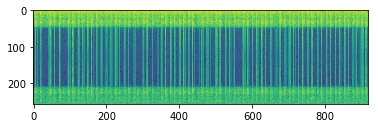

fs 174292-6-2-0.wav
280 :Loading file:  174292-6-2-0.wav  class:  gun_shot
(257, 871)


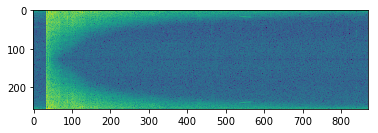

fs 28808-1-1-1.wav
281 :Loading file:  28808-1-1-1.wav  class:  car_horn
(257, 918)


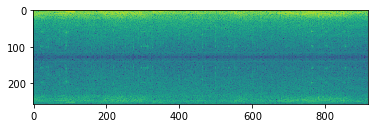

fs 171478-9-0-58.wav
fs 197554-2-0-26.wav
fs 136558-9-1-10.wav
fs 157207-6-10-0.wav
282 :Loading file:  157207-6-10-0.wav  class:  gun_shot
(257, 451)


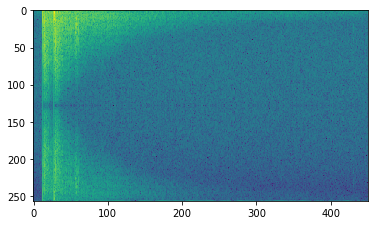

fs 208652-8-4-0.wav
283 :Loading file:  208652-8-4-0.wav  class:  siren
(257, 376)


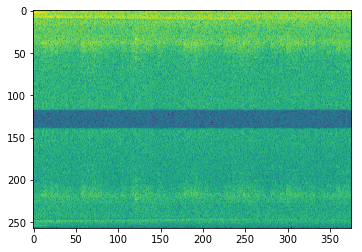

fs 74364-8-1-21.wav
284 :Loading file:  74364-8-1-21.wav  class:  siren
(257, 918)


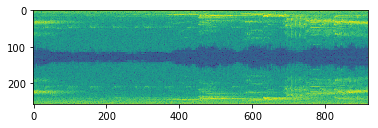

fs 102857-5-0-28.wav
285 :Loading file:  102857-5-0-28.wav  class:  engine_idling
(257, 918)


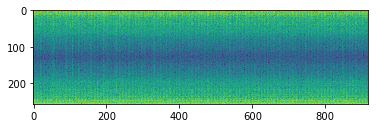

fs 172519-9-0-67.wav
fs 180127-4-0-11.wav
286 :Loading file:  180127-4-0-11.wav  class:  drilling
(257, 918)


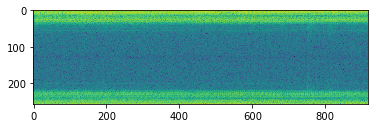

fs 129750-2-0-37.wav
287 :Loading file:  129750-2-0-37.wav  class:  children_playing
(257, 918)


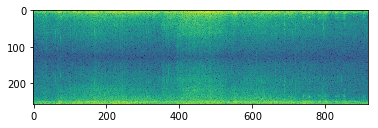

fs 165640-4-0-1.wav
288 :Loading file:  165640-4-0-1.wav  class:  drilling
(257, 918)


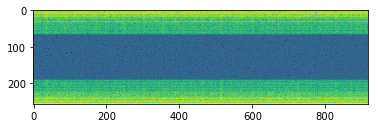

fs 102857-5-0-10.wav
289 :Loading file:  102857-5-0-10.wav  class:  engine_idling
(257, 918)


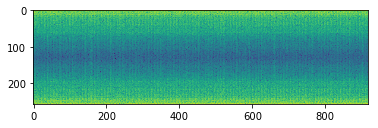

fs 164194-2-0-10.wav
fs 155241-9-0-8.wav
fs 171478-9-0-38.wav
fs 73524-0-0-8.wav
290 :Loading file:  73524-0-0-8.wav  class:  air_conditioner
(257, 459)


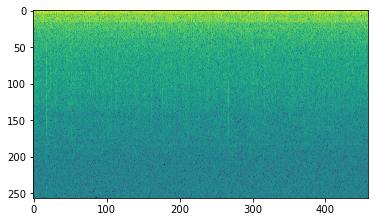

fs 101382-2-0-45.wav
291 :Loading file:  101382-2-0-45.wav  class:  children_playing
(257, 999)


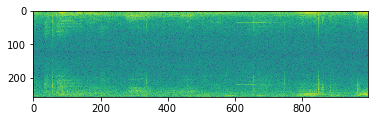

fs 159742-8-0-11.wav
fs 171478-9-0-28.wav
fs 181624-4-5-0.wav
fs 178826-2-0-12.wav
292 :Loading file:  178826-2-0-12.wav  class:  children_playing
(257, 999)


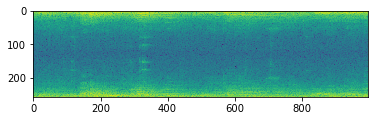

fs 69661-3-0-14.wav
293 :Loading file:  69661-3-0-14.wav  class:  dog_bark
(257, 918)


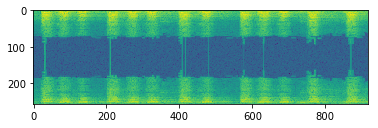

fs 178261-7-3-4.wav
fs 174292-6-1-0.wav
294 :Loading file:  174292-6-1-0.wav  class:  gun_shot
(257, 722)


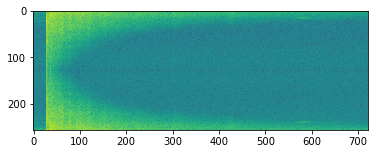

fs 102857-5-0-20.wav
295 :Loading file:  102857-5-0-20.wav  class:  engine_idling
(257, 918)


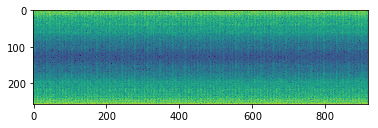

fs 93567-8-0-4.wav
296 :Loading file:  93567-8-0-4.wav  class:  siren
(257, 918)


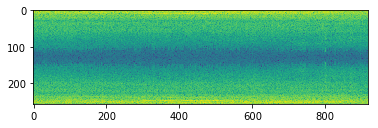

fs 39847-5-0-2.wav
297 :Loading file:  39847-5-0-2.wav  class:  engine_idling
(257, 918)


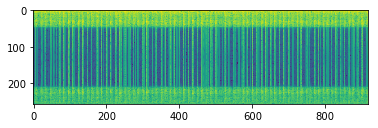

fs 157207-6-1-0.wav
298 :Loading file:  157207-6-1-0.wav  class:  gun_shot
(257, 734)


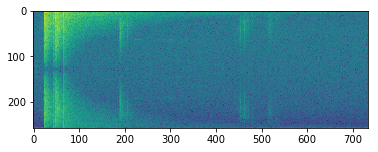

fs 208652-8-2-0.wav
299 :Loading file:  208652-8-2-0.wav  class:  siren
(257, 341)


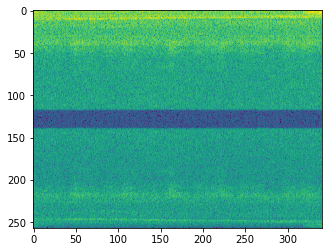

fs 171478-9-0-57.wav
fs 74364-8-1-12.wav
300 :Loading file:  74364-8-1-12.wav  class:  siren
(257, 918)


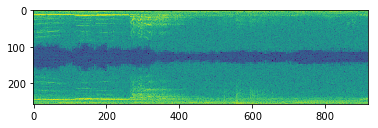

fs 162134-7-6-0.wav
fs 162134-7-10-1.wav
fs 180127-4-0-9.wav
301 :Loading file:  180127-4-0-9.wav  class:  drilling
(257, 918)


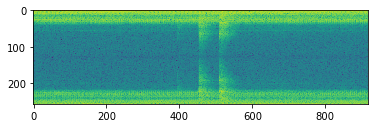

fs 202334-9-0-105.wav
fs 188497-2-0-19.wav
fs 118558-5-0-1.wav
302 :Loading file:  118558-5-0-1.wav  class:  engine_idling
(257, 459)


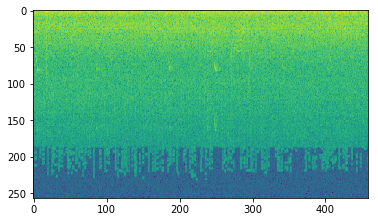

fs 83502-0-0-11.wav
303 :Loading file:  83502-0-0-11.wav  class:  air_conditioner
(257, 918)


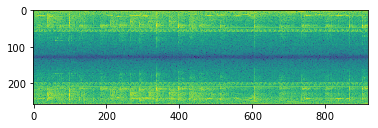

fs 155241-9-0-79.wav
fs 162134-7-14-2.wav
fs 74922-4-0-2.wav
fs 162134-7-11-1.wav
fs 39847-5-0-1.wav
304 :Loading file:  39847-5-0-1.wav  class:  engine_idling
(257, 918)


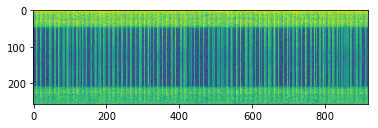

fs 118278-4-0-6.wav
305 :Loading file:  118278-4-0-6.wav  class:  drilling
(257, 999)


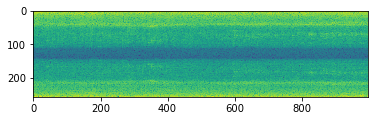

fs 159742-8-0-10.wav
fs 73524-0-0-105.wav
306 :Loading file:  73524-0-0-105.wav  class:  air_conditioner
(257, 459)


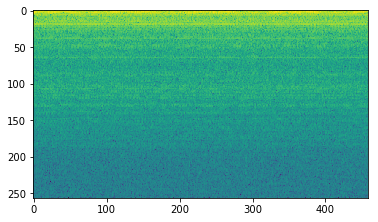

fs 129750-2-0-48.wav
307 :Loading file:  129750-2-0-48.wav  class:  children_playing
(257, 918)


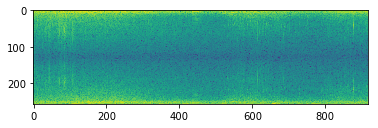

fs 162134-7-17-3.wav
fs 203424-9-0-4.wav
308 :Loading file:  203424-9-0-4.wav  class:  street_music
(257, 918)


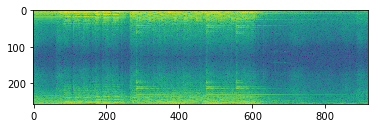

fs 141240-5-1-0.wav
fs 14470-2-0-56.wav
309 :Loading file:  14470-2-0-56.wav  class:  children_playing
(257, 918)


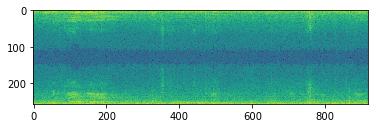

fs 100795-3-1-2.wav
310 :Loading file:  100795-3-1-2.wav  class:  dog_bark
(257, 918)


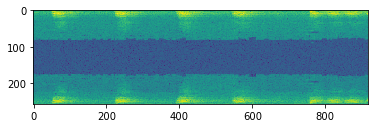

fs 100648-1-4-0.wav
311 :Loading file:  100648-1-4-0.wav  class:  car_horn
(257, 426)


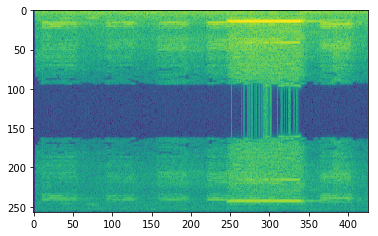

fs 74922-4-0-6.wav
fs 136558-9-0-1.wav
fs 162134-7-8-5.wav
fs 115241-9-0-14.wav
312 :Loading file:  115241-9-0-14.wav  class:  street_music
(257, 918)


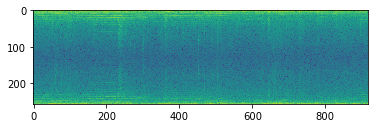

fs 188813-7-1-0.wav
fs 189982-0-0-2.wav
313 :Loading file:  189982-0-0-2.wav  class:  air_conditioner
(257, 918)


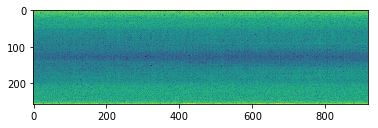

fs 157207-6-8-0.wav
314 :Loading file:  157207-6-8-0.wav  class:  gun_shot
(257, 238)


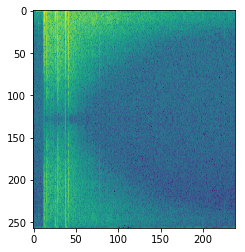

fs 83502-0-0-1.wav
315 :Loading file:  83502-0-0-1.wav  class:  air_conditioner
(257, 918)


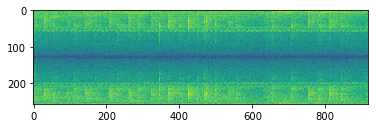

fs 157207-6-7-0.wav
316 :Loading file:  157207-6-7-0.wav  class:  gun_shot
(257, 232)


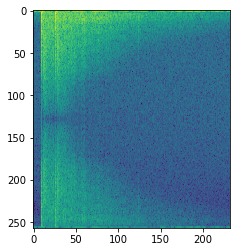

fs 180127-4-0-14.wav
317 :Loading file:  180127-4-0-14.wav  class:  drilling
(257, 918)


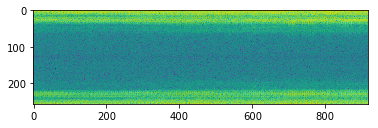

fs 66115-1-0-0.wav
318 :Loading file:  66115-1-0-0.wav  class:  car_horn
(257, 918)


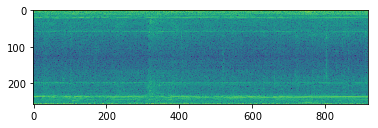

fs 165166-8-0-3.wav
319 :Loading file:  165166-8-0-3.wav  class:  siren
(257, 918)


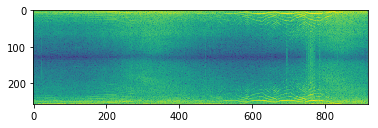

fs 155262-2-0-21.wav
fs 155262-2-0-2.wav
fs 22973-3-0-1.wav
320 :Loading file:  22973-3-0-1.wav  class:  dog_bark
(257, 918)


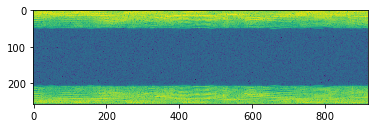

fs 83195-9-0-2.wav
321 :Loading file:  83195-9-0-2.wav  class:  street_music
(257, 499)


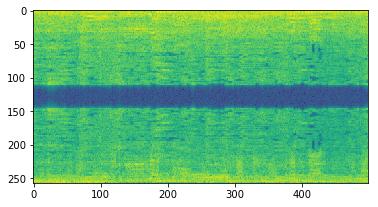

fs 41306-3-0-13.wav
322 :Loading file:  41306-3-0-13.wav  class:  dog_bark
(257, 918)


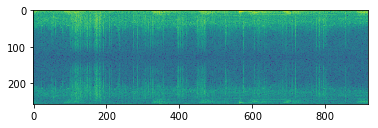

fs 171478-9-0-4.wav
fs 39847-5-1-0.wav
323 :Loading file:  39847-5-1-0.wav  class:  engine_idling
(257, 642)


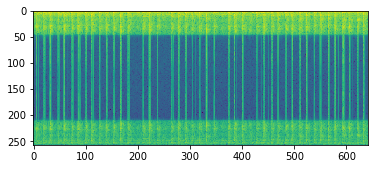

fs 188813-7-13-0.wav
fs 187110-2-0-10.wav
324 :Loading file:  187110-2-0-10.wav  class:  children_playing
(257, 918)


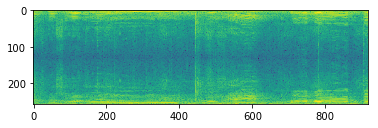

fs 83502-0-0-7.wav
325 :Loading file:  83502-0-0-7.wav  class:  air_conditioner
(257, 918)


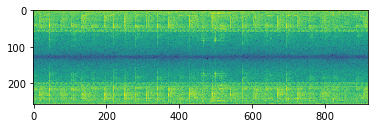

fs 99192-4-0-52.wav
326 :Loading file:  99192-4-0-52.wav  class:  drilling
(257, 459)


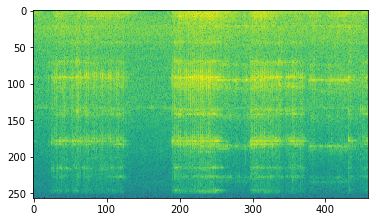

fs 162134-7-15-1.wav
fs 103438-5-0-2.wav
327 :Loading file:  103438-5-0-2.wav  class:  engine_idling
(257, 918)


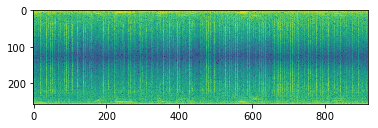

fs 162134-7-9-2.wav
fs 83502-0-0-2.wav
328 :Loading file:  83502-0-0-2.wav  class:  air_conditioner
(257, 918)


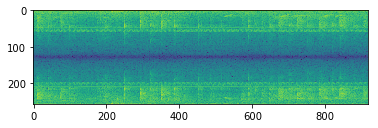

fs 102857-5-0-27.wav
329 :Loading file:  102857-5-0-27.wav  class:  engine_idling
(257, 918)


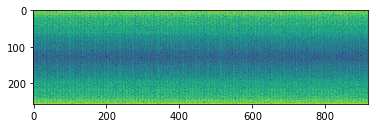

fs 28808-1-0-0.wav
330 :Loading file:  28808-1-0-0.wav  class:  car_horn
(257, 918)


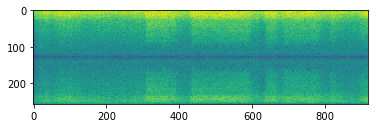

fs 7965-3-3-0.wav
331 :Loading file:  7965-3-3-0.wav  class:  dog_bark
(257, 272)


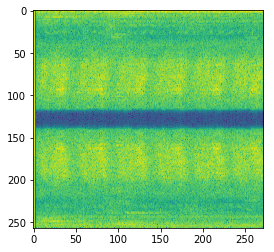

fs 102857-5-0-7.wav
332 :Loading file:  102857-5-0-7.wav  class:  engine_idling
(257, 918)


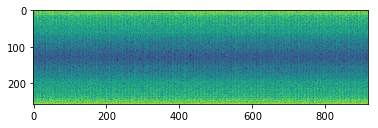

fs 167464-0-0-15.wav
fs 175850-1-0-0.wav
fs 157207-6-3-0.wav
333 :Loading file:  157207-6-3-0.wav  class:  gun_shot
(257, 205)


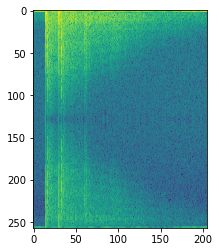

fs 15544-5-0-8.wav
fs 178826-2-0-14.wav
334 :Loading file:  178826-2-0-14.wav  class:  children_playing
(257, 999)


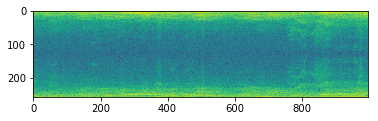

fs 27070-2-0-0.wav
335 :Loading file:  27070-2-0-0.wav  class:  children_playing
(257, 918)


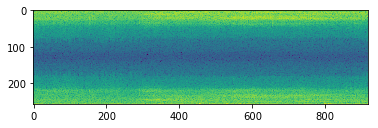

fs 187863-4-0-0.wav
336 :Loading file:  187863-4-0-0.wav  class:  drilling
(257, 166)


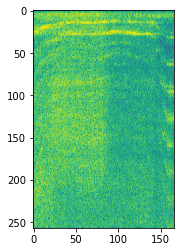

fs 187110-2-0-12.wav
337 :Loading file:  187110-2-0-12.wav  class:  children_playing
(257, 918)


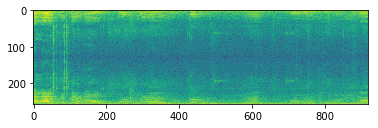

fs 178261-7-3-5.wav
fs 162134-7-13-1.wav
fs 14470-2-0-70.wav
338 :Loading file:  14470-2-0-70.wav  class:  children_playing
(257, 918)


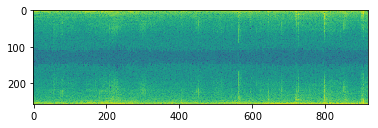

fs 157207-6-2-0.wav
339 :Loading file:  157207-6-2-0.wav  class:  gun_shot
(257, 268)


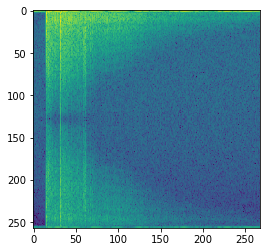

fs 196127-3-0-1.wav
fs 17486-3-2-0.wav
340 :Loading file:  17486-3-2-0.wav  class:  dog_bark
(257, 215)


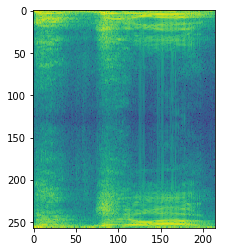

fs 167464-0-0-20.wav
fs 74364-8-1-6.wav
341 :Loading file:  74364-8-1-6.wav  class:  siren
(257, 918)


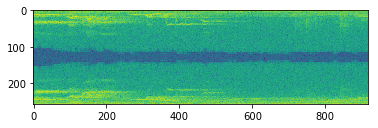

fs 178826-2-0-16.wav
342 :Loading file:  178826-2-0-16.wav  class:  children_playing
(257, 999)


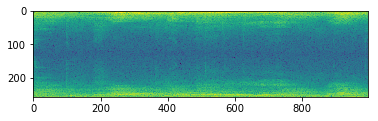

fs 88121-8-2-0.wav
343 :Loading file:  88121-8-2-0.wav  class:  siren
(257, 486)


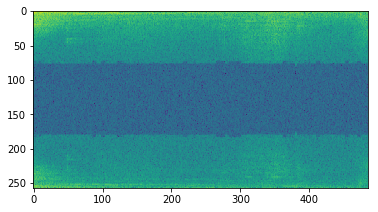

fs 72220-3-2-3.wav
344 :Loading file:  72220-3-2-3.wav  class:  dog_bark
(257, 918)


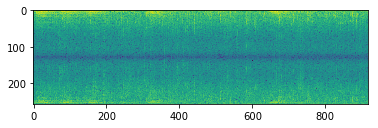

fs 165166-8-0-7.wav
345 :Loading file:  165166-8-0-7.wav  class:  siren
(257, 918)


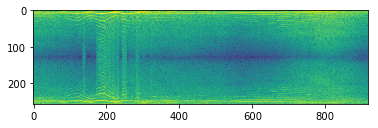

fs 14470-2-0-14.wav
346 :Loading file:  14470-2-0-14.wav  class:  children_playing
(257, 918)


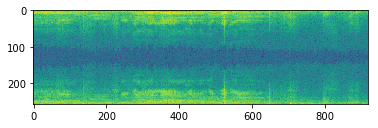

fs 159742-8-0-3.wav
fs 74364-8-1-13.wav
347 :Loading file:  74364-8-1-13.wav  class:  siren
(257, 918)


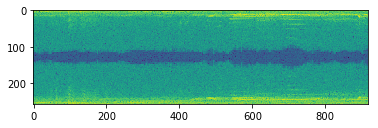

fs 100648-1-2-0.wav
348 :Loading file:  100648-1-2-0.wav  class:  car_horn
(257, 92)


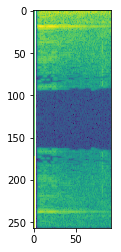

fs 189982-0-0-27.wav
349 :Loading file:  189982-0-0-27.wav  class:  air_conditioner
(257, 918)


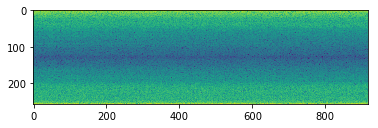

fs 178826-2-0-10.wav
350 :Loading file:  178826-2-0-10.wav  class:  children_playing
(257, 999)


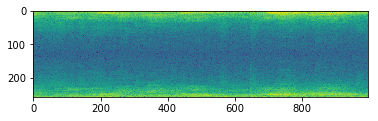

fs 178261-7-1-0.wav
fs 115418-9-0-11.wav
fs 74364-8-1-19.wav
351 :Loading file:  74364-8-1-19.wav  class:  siren
(257, 918)


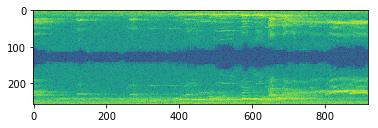

fs 93567-8-0-18.wav
352 :Loading file:  93567-8-0-18.wav  class:  siren
(257, 918)


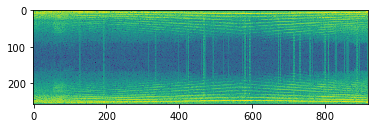

fs 188813-7-7-0.wav
fs 138017-9-0-9.wav
353 :Loading file:  138017-9-0-9.wav  class:  street_music
(257, 918)


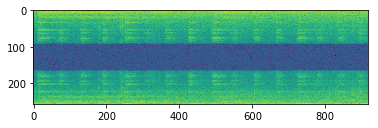

fs 83195-9-0-11.wav
354 :Loading file:  83195-9-0-11.wav  class:  street_music
(257, 499)


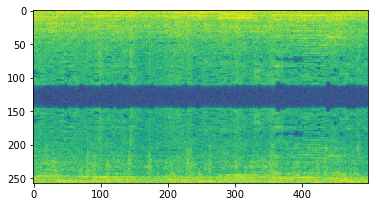

fs 189982-0-0-36.wav
355 :Loading file:  189982-0-0-36.wav  class:  air_conditioner
(257, 918)


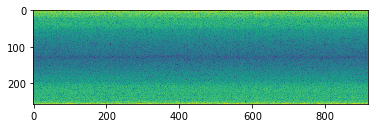

fs 155241-9-0-50.wav
fs 167464-0-0-0.wav
fs 164194-2-0-29.wav
fs 99192-4-0-24.wav
356 :Loading file:  99192-4-0-24.wav  class:  drilling
(257, 459)


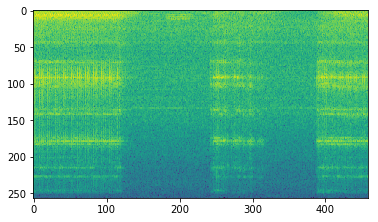

fs 202334-9-0-63.wav
fs 164646-6-0-0.wav
357 :Loading file:  164646-6-0-0.wav  class:  gun_shot
(257, 98)


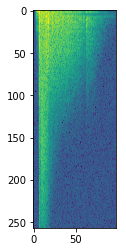

fs 117889-9-0-36.wav
358 :Loading file:  117889-9-0-36.wav  class:  street_music
(257, 918)


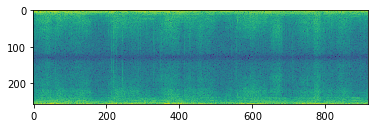

fs 162134-7-4-0.wav
fs 71312-3-0-2.wav
359 :Loading file:  71312-3-0-2.wav  class:  dog_bark
(257, 918)


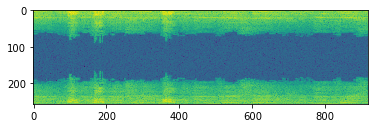

fs 20571-3-1-0.wav
360 :Loading file:  20571-3-1-0.wav  class:  dog_bark
(257, 918)


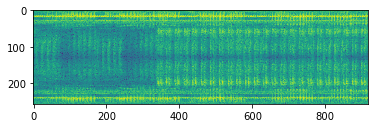

fs 73524-0-0-137.wav
361 :Loading file:  73524-0-0-137.wav  class:  air_conditioner
(257, 459)


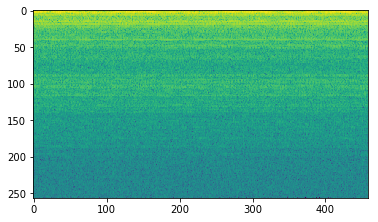

fs 14468-3-0-3.wav
362 :Loading file:  14468-3-0-3.wav  class:  dog_bark
(257, 918)


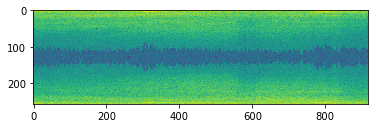

fs 188813-7-9-0.wav
fs 162134-7-10-2.wav
fs 162134-7-8-4.wav
fs 7913-3-1-0.wav
363 :Loading file:  7913-3-1-0.wav  class:  dog_bark
(257, 173)


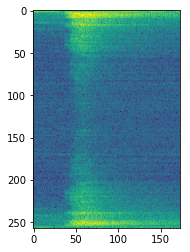

fs 88121-8-0-0.wav
364 :Loading file:  88121-8-0-0.wav  class:  siren
(257, 999)


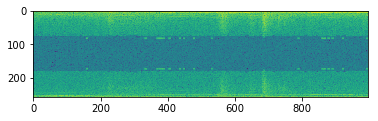

fs 188813-7-12-0.wav
fs 196127-3-0-0.wav
fs 167464-0-0-6.wav
fs 188497-2-0-2.wav
fs 202334-9-0-106.wav
fs 84249-9-0-6.wav
365 :Loading file:  84249-9-0-6.wav  class:  street_music
(257, 499)


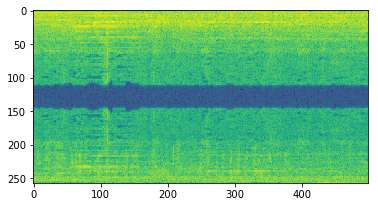

fs 77927-3-1-1.wav
366 :Loading file:  77927-3-1-1.wav  class:  dog_bark


KeyboardInterrupt: 

In [5]:
features, labels  = extract_features()

In [ ]:
fd = open("/nobackup/leopauly/S2LStage2/data_x.pkl", 'wb')
pickle.dump(features, fd)
fd2 = open("/nobackup/leopauly/S2LStage2/data_y.pkl", 'wb')
pickle.dump(labels, fd2)

In [ ]:
check=444
plt.imshow(features[check])
print('Class:', classes[str(labels[check])])
plt.show()


In [ ]:
## Loading data
print("Start loading data")

fd_x= open("/nobackup/leopauly/S2LStage2/data_x.pkl", 'rb')
fd_y = open("/nobackup/leopauly/S2LStage2/data_y.pkl", 'rb')

features = pickle.load(fd_x)
labels = pickle.load(fd_y)

print("Data loaded")

In [ ]:
plt.imshow(features[check])
print('Class:', classes[str(labels[check])])
plt.show()